In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_columns",None)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data_final=pd.read_csv(r"/content/drive/Shareddrives/DATA606 capstone project/final_data.csv").drop(columns=["Unnamed: 0"])

In [ ]:
data_final.head()

,datetime,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment,temp,dew,humidity,precip,precipprob,windgust,windspeed,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,hour,day,month
0,2020-01-01 01:00:00,261642.173073,0.0,3406.967436,258235.205637,20091.520292,27279.731877,15895.241613,99143.546667,162410.879518,99144.385736,87.746888,0.0,0.0,6.3,5.1,92.32,0.0,0,10.4,0.5,1021.1,8.7,6.4,0.0,0.0,0,0.0,Clear,1,1,1
1,2020-01-01 02:00:00,252464.832604,0.0,5967.002946,246497.829658,22649.576156,27273.699994,14712.373468,91953.413333,160451.063841,95815.414224,60.355430,0.0,0.0,6.2,5.1,92.32,0.0,0,10.1,0.5,1021.4,8.7,5.3,0.0,0.0,0,0.0,Clear,2,1,1
2,2020-01-01 03:00:00,245416.002344,0.0,6199.244249,239216.758095,22898.479955,27280.022811,14073.236606,93985.426667,151384.511224,87132.771853,46.064453,0.0,0.0,5.8,5.1,95.57,0.0,0,11.5,5.8,1021.1,8.7,5.1,0.0,0.0,0,0.0,Clear,3,1,1
3,2020-01-01 04:00:00,241363.031667,0.0,5080.579630,236282.452037,21691.987069,27280.588677,14248.185413,94369.893333,146970.820052,83750.058893,22.318281,0.0,0.0,6.1,5.0,92.25,0.0,0,11.9,4.9,1020.8,5.0,10.5,0.0,0.0,0,0.0,Clear,4,1,1
4,2020-01-01 05:00:00,239642.357318,0.0,9443.764928,230198.592389,26065.495828,27262.534627,15167.772388,93689.306667,145981.897747,77486.094904,-28.847096,0.0,0.0,5.2,4.0,92.37,0.0,0,11.9,0.5,1020.1,5.0,10.5,0.0,0.0,0,0.0,Clear,5,1,1


#Modeling

##Research Question 1

**How do weather conditions and energy generation factors influence electricity demand during peak load seasons, and what key drivers significantly impact these fluctuations?**

- old question:
how can we model the combined effect of renewable and traditional power sources to ensure grid stability?



In [ ]:
features = ['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity', 'wind']
target = 'load'

X = data_final[features]
y = data_final[target]

###Linear Regression

### Linear Regression Model Performance ###

Training Performance:
R²: 0.7009330012612438
Mean Absolute Error (MAE): 34771.492194242994
Mean Squared Error (MSE): 2142155831.07879

Test Performance:
R²: 0.7129336596855201
Mean Absolute Error (MAE): 34358.710710322775
Mean Squared Error (MSE): 2062269638.9082224


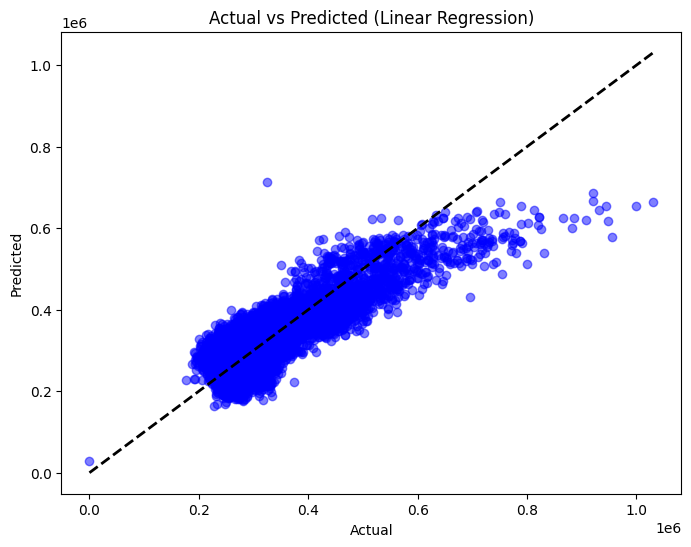

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Linear Regression model
linear_reg = LinearRegression()

# Fit the model on training data
linear_reg.fit(X_train, y_train)

# Make predictions on training and test data
y_train_pred = linear_reg.predict(X_train)
y_test_pred = linear_reg.predict(X_test)

# Print heading and evaluate the model on training data
print("### Linear Regression Model Performance ###\n")
print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

# Print heading and evaluate the model on test data
print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plotting actual vs predicted values for test data
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Linear Regression)')
plt.show()

**Interpretation:**
The Linear Regression model captures a moderate amount of variance but lacks the ability to accurately predict the target values, especially at higher levels. The model's consistent performance across training and test sets indicates no severe overfitting, but the low R² score and high error metrics suggest that linear regression may be insufficient for accurately modeling this problem.

###Ridge and Lasso Regression

### Ridge Regression Model Performance ###

Training Performance:
R²: 0.7009330012610056
Mean Absolute Error (MAE): 34771.48981050533
Mean Squared Error (MSE): 2142155831.080497

Test Performance:
R²: 0.7129336644820243
Mean Absolute Error (MAE): 34358.70856838946
Mean Squared Error (MSE): 2062269604.4503868


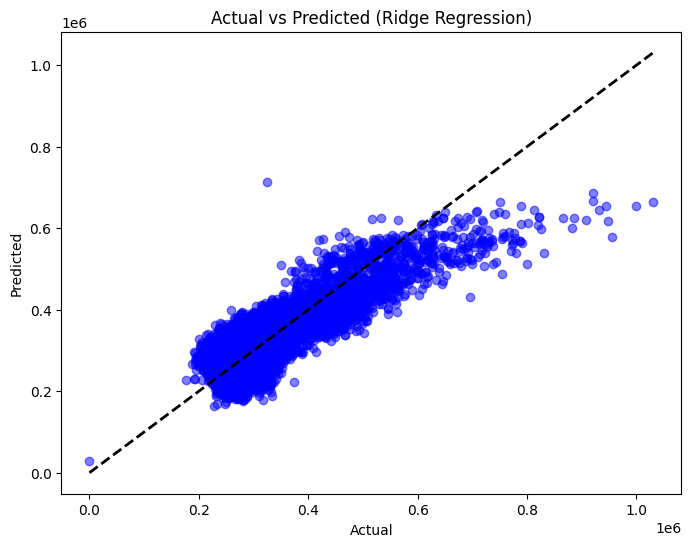


### Lasso Regression Model Performance ###

Training Performance:
R²: 0.6852854195093253
Mean Absolute Error (MAE): 35626.89676236565
Mean Squared Error (MSE): 2254236263.334823

Test Performance:
R²: 0.6936736922548523
Mean Absolute Error (MAE): 35306.83235553887
Mean Squared Error (MSE): 2200632241.904851


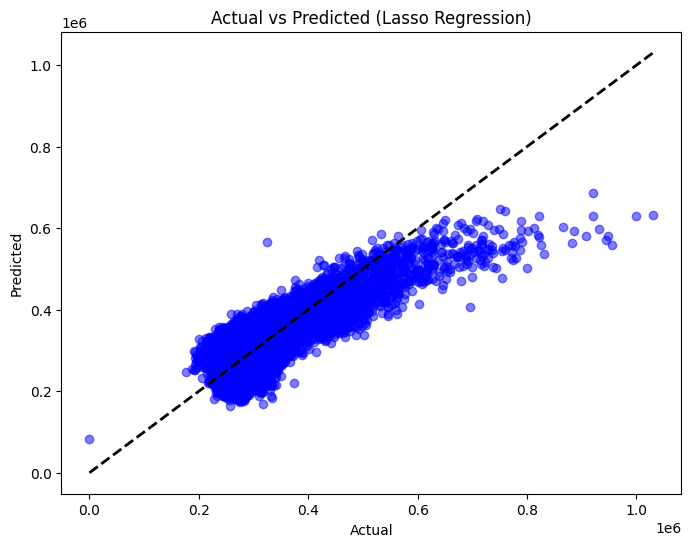

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Ridge Regression
ridge_reg = Ridge(alpha=1.0)  # Adjust alpha for regularization strength
ridge_reg.fit(X_train, y_train)
y_train_pred_ridge = ridge_reg.predict(X_train)
y_test_pred_ridge = ridge_reg.predict(X_test)

print("### Ridge Regression Model Performance ###\n")
print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_ridge))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_ridge))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_ridge))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_ridge))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_ridge))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_ridge))

# Optional: Plot actual vs predicted values for Ridge
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_ridge, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Ridge Regression)')
plt.show()

# Lasso Regression
lasso_reg = Lasso(alpha=0.1)  # Adjust alpha for regularization strength
lasso_reg.fit(X_train, y_train)
y_train_pred_lasso = lasso_reg.predict(X_train)
y_test_pred_lasso = lasso_reg.predict(X_test)

print("\n### Lasso Regression Model Performance ###\n")
print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_lasso))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_lasso))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_lasso))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_lasso))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_lasso))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_lasso))

# Optional: Plot actual vs predicted values for Lasso
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_lasso, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Lasso Regression)')
plt.show()

**Interpretation:**
1. **Ridge Regression** performed almost identically to Linear Regression, with minimal differences in metrics such as R², MAE, and MSE for both training and test sets. This indicates that adding Ridge regularization (L2 penalty) had little effect on model performance, likely because the original Linear Regression model did not suffer from overfitting to the extent where regularization would help significantly.

2. **Lasso Regression** has not provided a significant improvement compared to Linear or Ridge Regression models. The R² score, MAE, and MSE values are nearly identical, indicating that Lasso regularization did not have a notable effect on the model's performance.
  - Lasso did not effectively reduce coefficients to zero, which suggests that all features might still be contributing similarly to the prediction, or that the dataset might not have strong irrelevant features for Lasso to remove.

###Polynomial Regression

### Polynomial Regression (Degree = 2) ###

Training Performance:
R²: 0.8478917854951773
Mean Absolute Error (MAE): 24517.907302731644
Mean Squared Error (MSE): 1089520074.19956

Test Performance:
R²: 0.8514396392175938
Mean Absolute Error (MAE): 24565.89869220685
Mean Squared Error (MSE): 1067249895.0980443


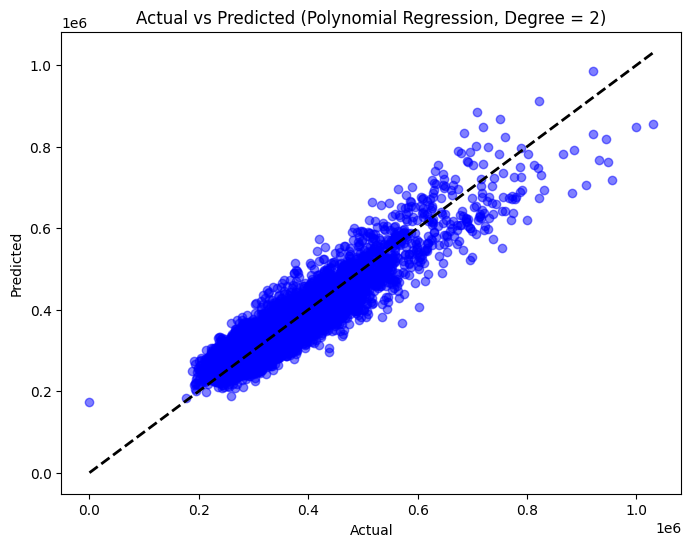

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the degree of the polynomial
degree = 2  # You can adjust this to increase model complexity

# Create polynomial features
poly_features = PolynomialFeatures(degree=degree)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

# Initialize and train the linear regression model on polynomial features
poly_reg_model = LinearRegression()
poly_reg_model.fit(X_train_poly, y_train)

# Make predictions on the training and test sets
y_train_pred_poly = poly_reg_model.predict(X_train_poly)
y_test_pred_poly = poly_reg_model.predict(X_test_poly)

# Print model performance
print(f"### Polynomial Regression (Degree = {degree}) ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_poly))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_poly))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_poly))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_poly))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_poly))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_poly))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_poly, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title(f'Actual vs Predicted (Polynomial Regression, Degree = {degree})')
plt.show()

**Interpretation:**

The polynomial regression model (degree = 2) performs well, explaining about 85% of the variance in both the training and test sets. The average prediction error (MAE) is approximately 24,500 units, indicating that predictions are fairly accurate but still have some variability. The consistency between training and test metrics suggests the model generalizes well without overfitting. However, some non-linearity and errors remain, suggesting there could still be room for further improvement through enhanced modeling or feature engineering.

          Feature   Coefficient  Abs_Coefficient
4            temp -22939.754461     22939.754461
6           month  -8606.423881      8606.423881
5            hour  -1382.265716      1382.265716
7        humidity    579.479909       579.479909
32     temp month    525.414307       525.414307
30         temp^2    378.794390       378.794390
39        month^2    268.285135       268.285135
35         hour^2    151.407908       151.407908
33  temp humidity     51.037619        51.037619
36     hour month    -41.512576        41.512576


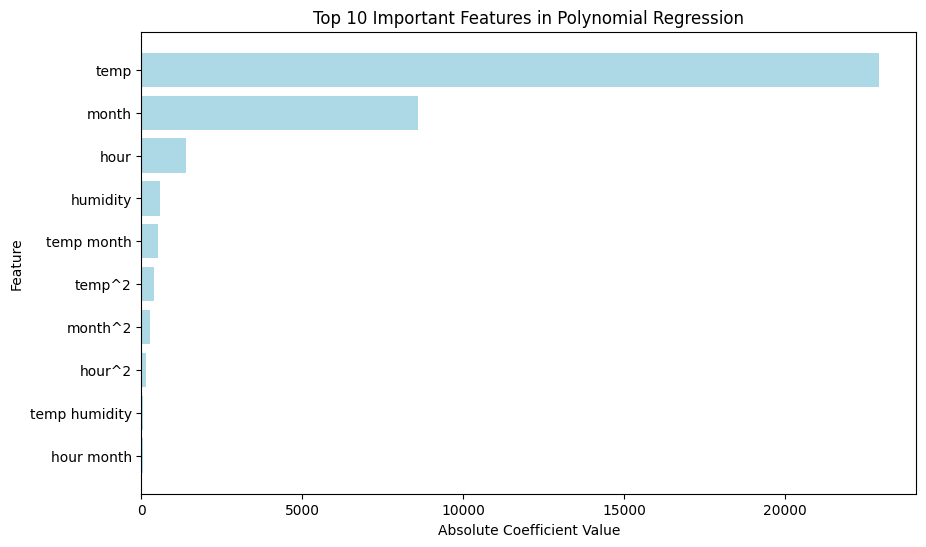

In [ ]:
import numpy as np
import pandas as pd

# Get the model coefficients
coefficients = poly_reg_model.coef_

# Get feature names from the PolynomialFeatures object
feature_names = poly_features.get_feature_names_out(input_features=X.columns)

# Create a DataFrame for easier visualization
coeff_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

# Sort coefficients by their absolute value (importance)
coeff_df['Abs_Coefficient'] = coeff_df['Coefficient'].abs()
coeff_df = coeff_df.sort_values(by='Abs_Coefficient', ascending=False)

# Display the top 10 most important features
print(coeff_df.head(10))

# Optional: Visualize the coefficients
plt.figure(figsize=(10, 6))
plt.barh(coeff_df['Feature'][:10], coeff_df['Abs_Coefficient'][:10], color='lightblue')
plt.xlabel('Absolute Coefficient Value')
plt.ylabel('Feature')
plt.title('Top 10 Important Features in Polynomial Regression')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


**Interpretation:**

The feature importance analysis shows that temperature (`temp`) has the most significant impact on curtailment prediction, followed by `month` and `hour`. This indicates that curtailment is highly influenced by temperature and seasonal variations. Interaction terms, such as `temp month` and `temp^2`, also contribute, but to a lesser extent. Overall, temperature is the dominant factor affecting curtailment, making it the key focus for optimizing prediction and management strategies.

###Decision Tree Regression

### Decision Tree Regression Model Performance ###

Training Performance:
R²: 0.7609018554792562
Mean Absolute Error (MAE): 28224.05065522143
Mean Squared Error (MSE): 1712611176.2422829

Test Performance:
R²: 0.7529594189840022
Mean Absolute Error (MAE): 28640.048290111892
Mean Squared Error (MSE): 1774726668.5791986


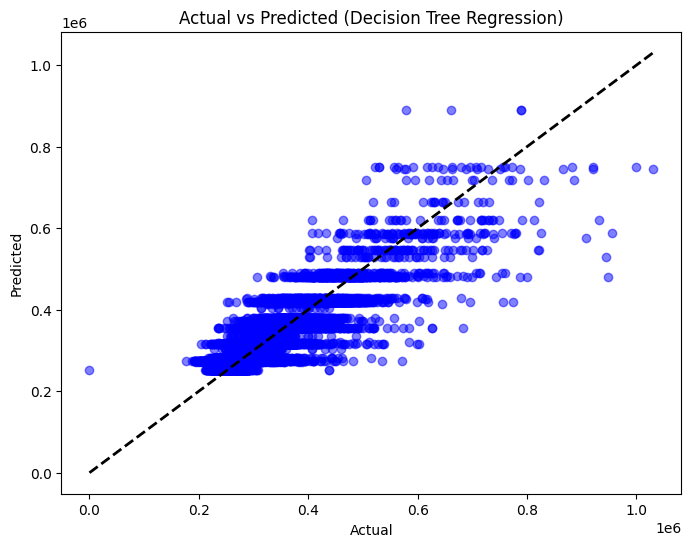

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Decision Tree Regressor
tree_reg = DecisionTreeRegressor(random_state=42, max_depth=5)  # Adjust max_depth to control complexity

# Fit the model on training data
tree_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred_dec = tree_reg.predict(X_train)
y_test_pred_dec = tree_reg.predict(X_test)

# Print model performance
print("### Decision Tree Regression Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_dec))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_dec))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_dec))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_dec))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_dec))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_dec))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_dec, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Decision Tree Regression)')
plt.show()# Import necessary libraries


**Interpretation:**

The Decision Tree Regression model shows moderate performance, with an R² of 0.76 for the training set and 0.75 for the test set. This indicates that the model captures about 75% of the variability in the data. However, the Mean Absolute Error (MAE) of around 28,000 suggests that the predictions have substantial deviations from the actual values. The relatively high Mean Squared Error (MSE) also points to significant variance in the prediction errors, indicating that the model is not highly precise. Overall, while the Decision Tree can explain some variability, there is considerable room for improvement to reduce error.

**Tuning Of Decision Tree**

Fitting 5 folds for each of 180 candidates, totalling 900 fits
Best Parameters: {'max_depth': 10, 'max_features': None, 'min_samples_leaf': 4, 'min_samples_split': 10}

### Decision Tree Regression Model Performance (Training Set) ###

R²: 0.8906422452389529
Mean Absolute Error (MAE): 19391.615601879035
Mean Squared Error (MSE): 783307262.3291872

### Decision Tree Regression Model Performance (Test Set) ###

R²: 0.8288348904207057
Mean Absolute Error (MAE): 22363.12924870575
Mean Squared Error (MSE): 1229641233.239258


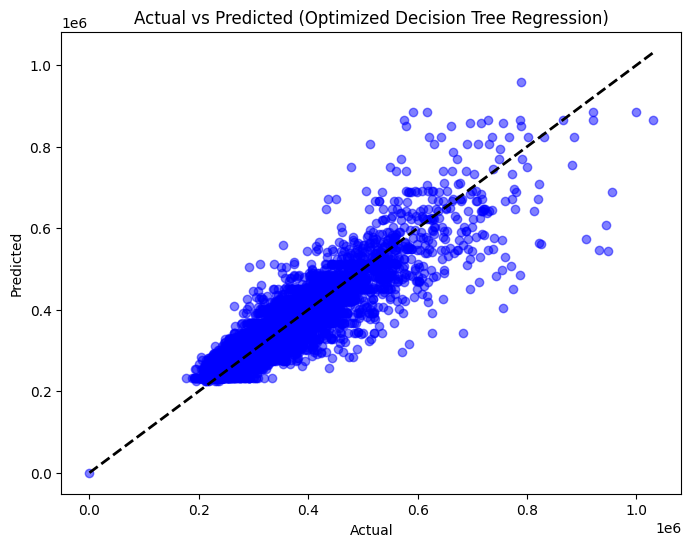

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the parameter grid
param_grid = {
    'max_depth': [3, 5, 7, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2', None]
}

# Initialize the Decision Tree Regressor
tree_reg = DecisionTreeRegressor(random_state=42)

# Set up the GridSearchCV
grid_search = GridSearchCV(estimator=tree_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=5, n_jobs=-1, verbose=2)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Print the best parameters
print("Best Parameters:", grid_search.best_params_)

# Use the best estimator for predictions
best_tree_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred_dectune = best_tree_reg.predict(X_train)
y_test_pred_dectune = best_tree_reg.predict(X_test)

# Print model performance for training set
print("\n### Decision Tree Regression Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred_dectune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_dectune))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_dectune))

# Print model performance for test set
print("\n### Decision Tree Regression Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred_dectune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_dectune))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_dectune))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_dectune, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Decision Tree Regression)')
plt.show()


**Interpretation:**

The optimized Decision Tree Regression model shows an improvement over the previous version. With an R² of 0.89 for the training set, the model captures 89% of the variability in the data, suggesting it is fitting the training set quite well. The R² for the test set is 0.83, indicating that the model generalizes reasonably well to unseen data.

The Mean Absolute Error (MAE) for the training set is approximately 19,392, while for the test set, it is around 22,363. These values indicate reduced prediction errors compared to the earlier Decision Tree model. The Mean Squared Error (MSE) values are also lower, suggesting that the variance in the prediction errors has decreased.

Overall, the optimized model provides a better fit, showing higher accuracy and lower prediction errors, although it still has room for improvement in handling variance in predictions.


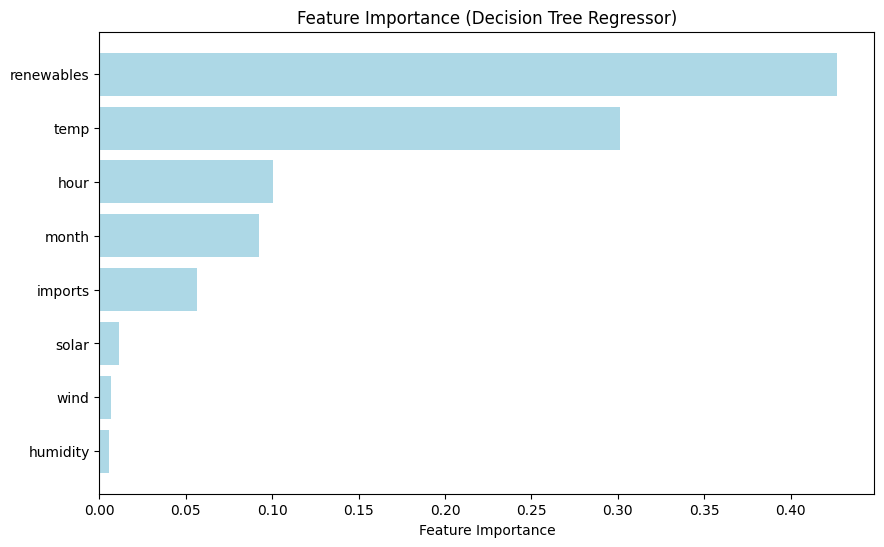

In [ ]:
import numpy as np

# Get feature importances from the best estimator
importances = best_tree_reg.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances)), importances[indices], align='center', color='lightblue')
plt.yticks(range(len(importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Decision Tree Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


**Interpretation:**

The feature importance plot shows that **renewables** and **temperature** are the most significant factors in predicting the target variable. **Hour**, **month**, and **imports** have moderate importance, while **solar**, **wind**, and **humidity** contribute minimally. This indicates that renewable generation and temperature are key drivers for the model.

###Bagging Regressor

### Bagging Regressor Model Performance ###

Training Performance:
R²: 0.9839668975335281
Mean Absolute Error (MAE): 6800.012858941448
Mean Squared Error (MSE): 114841838.39634666

Test Performance:
R²: 0.8912483136496746
Mean Absolute Error (MAE): 17935.600637265732
Mean Squared Error (MSE): 781266451.1438483


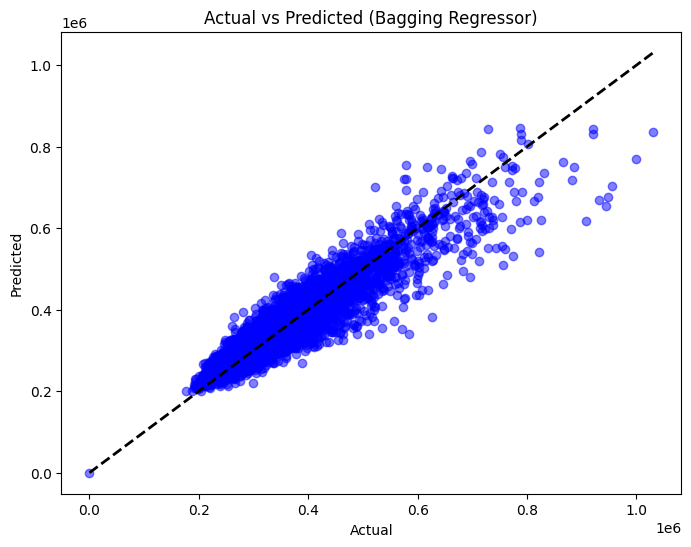

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the base model (Decision Tree) and Bagging Regressor
base_model = DecisionTreeRegressor(random_state=42)
bagging_reg = BaggingRegressor(estimator=base_model, n_estimators=50, random_state=42)

# Fit the Bagging Regressor on training data
bagging_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred_bagg = bagging_reg.predict(X_train)
y_test_pred_bagg = bagging_reg.predict(X_test)

# Print model performance
print("### Bagging Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_bagg))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_bagg))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_bagg))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_bagg))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_bagg))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_bagg))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_bagg, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Bagging Regressor)')
plt.show()

**Interpretation:**

The Bagging Regressor model demonstrates strong predictive performance. On the training set, it achieves an R² of 0.984, indicating that the model explains almost all the variance in the data, with low errors (MAE = 6800, MSE = 114.8 million). The test set also shows good performance, with an R² of 0.891, though there is some drop compared to the training set, suggesting potential overfitting. The errors on the test set (MAE = 17935, MSE = 781.3 million) indicate that the model still performs well but may struggle slightly with generalization.

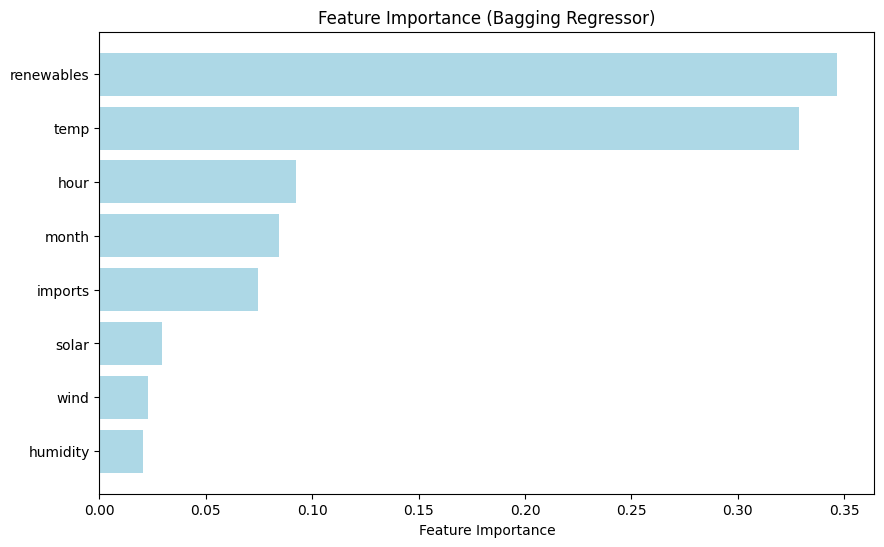

In [ ]:
import numpy as np

# Calculate average feature importances from all decision trees in the ensemble
feature_importances = np.mean([tree.feature_importances_ for tree in bagging_reg.estimators_], axis=0)

# Sort the feature importances in descending order
indices = np.argsort(feature_importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_importances)), feature_importances[indices], align='center', color='lightblue')
plt.yticks(range(len(feature_importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Bagging Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


**Interpretation:**

The feature importance plot for the Bagging Regressor model reveals that renewables and temperature are the most influential features in predicting the target variable, contributing significantly more compared to other features. These two variables have the highest importance scores, indicating that they are crucial for accurately predicting outcomes in the model. Features like hour, month, and imports also contribute, albeit to a lesser extent, while solar, wind, and humidity are among the least influential. This suggests that renewable generation and temperature dynamics are key drivers of the model's predictions.

###Random Forest REgressor

In [ ]:
features = ['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity', 'wind']
target = 'load'

X = data_final[features]
y = data_final[target]

### Random Forest Regressor Model Performance ###

Training Performance:
R²: 0.9845456651446939
Mean Absolute Error (MAE): 6737.259607694017
Mean Squared Error (MSE): 110696244.20398471

Test Performance:
R²: 0.893498182927067
Mean Absolute Error (MAE): 17800.5373725992
Mean Squared Error (MSE): 765103507.4243032


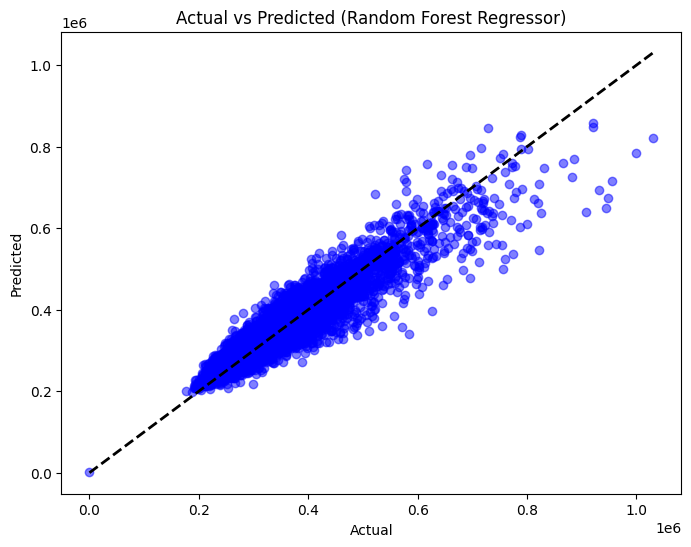

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Random Forest Regressor
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model on training data
rf_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred_random = rf_reg.predict(X_train)
y_test_pred_random = rf_reg.predict(X_test)

# Print model performance
print("### Random Forest Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_random))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_random))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_random))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_random))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_random))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_random))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_random, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Random Forest Regressor)')
plt.show()

**Interpretation:**

The Random Forest Regressor model shows excellent performance on the training set with an R² of 0.98, indicating that the model fits the training data very well. The Mean Absolute Error (MAE) of around 6,737 and a Mean Squared Error (MSE) of approximately 110 million reflect minimal errors in predictions for training data.

For the test set, the model still performs well, with an R² of 0.89, suggesting it can explain a large portion of the variability in the test data. The MAE of 17,800 and MSE of 765 million indicate that the model is able to generalize reasonably to unseen data, although it is slightly overfitting given the lower performance metrics compared to the training data. This gap suggests that there is some variance the model captures in the training data that may not generalize perfectly to the test data.

Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best Parameters: {'max_depth': 20, 'max_features': 'log2', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Score (negative MSE): -840763496.2635812

### Random Forest Regressor Model Performance (Training Set) ###

R²: 0.96505454129729
Mean Absolute Error (MAE): 10306.600294856265
Mean Squared Error (MSE): 250307183.49209964

### Random Forest Regressor Model Performance (Test Set) ###

R²: 0.8924303270740552
Mean Absolute Error (MAE): 17878.60105869814
Mean Squared Error (MSE): 772774928.2602813


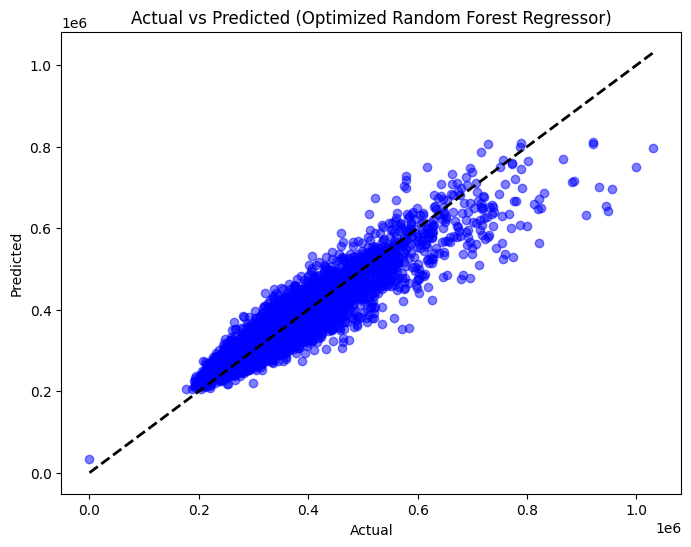

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define a reduced parameter grid to speed up GridSearchCV
param_grid = {
    'n_estimators': [50, 100],                # Fewer values for faster training
    'max_depth': [10, 20],                    # Reduced number of options
    'min_samples_split': [5, 10],             # Reduced options for splitting nodes
    'min_samples_leaf': [2, 4],               # Reduced options for leaf nodes
    'max_features': ['sqrt', 'log2']          # Avoid 'auto' as it can be computationally expensive
}

# Initialize the RandomForestRegressor
rf_reg = RandomForestRegressor(random_state=42)

# Set up the GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=rf_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit GridSearchCV to the training data (Reduced parameter grid and cv)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_rf_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred_rantune = best_rf_reg.predict(X_train)
y_test_pred_rantune = best_rf_reg.predict(X_test)

# Print model performance for the training set
print("\n### Random Forest Regressor Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_rantune))

# Print model performance for the test set
print("\n### Random Forest Regressor Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_rantune))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_rantune, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Random Forest Regressor)')
plt.show()


**Interpreation:**

The Optimized Random Forest Regressor performs well, with an R² of 0.96 on training and 0.89 on test data, indicating good model accuracy. However, the lower test set performance compared to training suggests slight overfitting, meaning the model fits the training data better than unseen data.

In [ ]:
pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=c3fdeb3e930c7dfb948d936b436b04326ffbcb148c2c2b459a4e8d22e93a4db9
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
# Print features used in training and features currently in X
print("Features used in training:", best_rf_reg.feature_names_in_)
print("Current features in X:", X.columns)


Features used in training: ['solar' 'renewables' 'imports' 'temp' 'hour' 'month' 'humidity' 'wind']
Current features in X: Index(['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity',
       'wind'],
      dtype='object')


In [ ]:
# Assuming the missing column is 'some_feature'
if 'some_feature' not in X.columns:
    X['some_feature'] = 0  # Fill with default or appropriate value (e.g., mean, median, etc.)


In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Initialize the LIME explainer
explainer_rf_tuned = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X.columns,
    mode='regression'
)

# Select an instance to explain
instance_index_rf_tuned = 8  # Adjust index as needed
instance_to_explain_rf_tuned = X_test.iloc[instance_index_rf_tuned].values.reshape(1, -1)

# Explain the prediction
exp_rf_tuned = explainer_rf_tuned.explain_instance(
    data_row=X_test.iloc[instance_index_rf_tuned],
    predict_fn=best_rf_reg.predict
)

# Display the explanation
exp_rf_tuned.show_in_notebook(show_table=True)


**Interpretation:**

The interpretation shows that high values of renewables and solar contributed significantly to the positive prediction, while moderate values of temp, hour, and wind had a negative impact on the outcome.

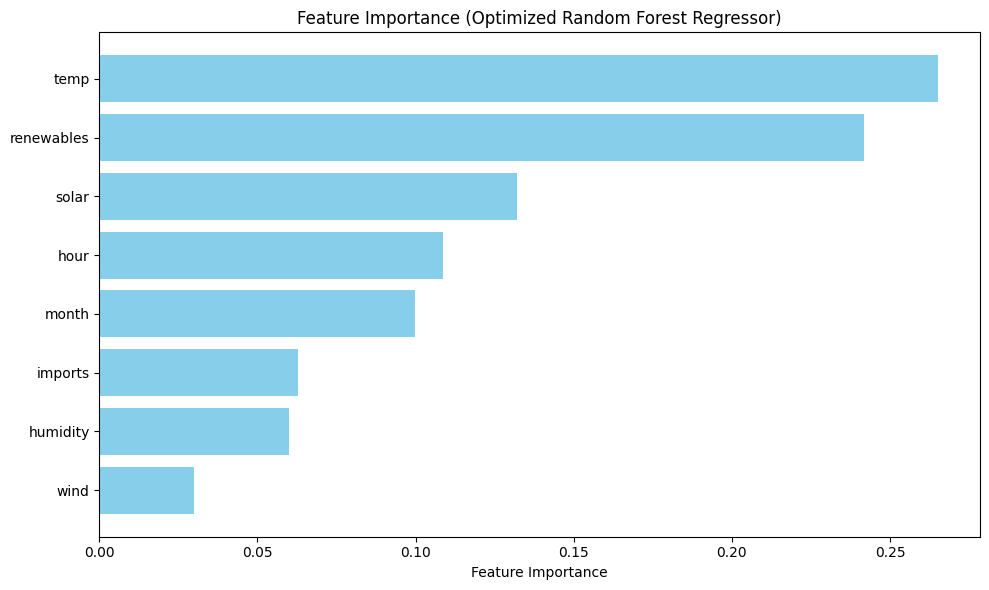

In [ ]:
# Import necessary libraries
import matplotlib.pyplot as plt
import numpy as np

# Extract feature importances from the optimized Random Forest model
importances_rf = best_rf_reg.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances_rf)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances_rf)), importances_rf[indices], align='center', color='skyblue')
plt.yticks(range(len(importances_rf)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Optimized Random Forest Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.tight_layout()
plt.show()


**Interpretation:**

- Temperature (temp) and Renewable energy (renewables) have the highest influence on the model's predictions, contributing significantly to its accuracy.
- Solar, Hour, and Month also have substantial effects, indicating they play key roles in predicting the target variable.
- Features like Imports, Humidity, and Wind have comparatively lower importance, indicating a lesser but still relevant impact on the model's performance.



###GRadient Boosting Regressor

### Gradient Boosting Regressor Model Performance ###

Training Performance:
R²: 0.8747030594537799
Mean Absolute Error (MAE): 20913.494417321082
Mean Squared Error (MSE): 897476394.7187568

Test Performance:
R²: 0.8652919095211323
Mean Absolute Error (MAE): 21337.10487704483
Mean Squared Error (MSE): 967735906.6393402


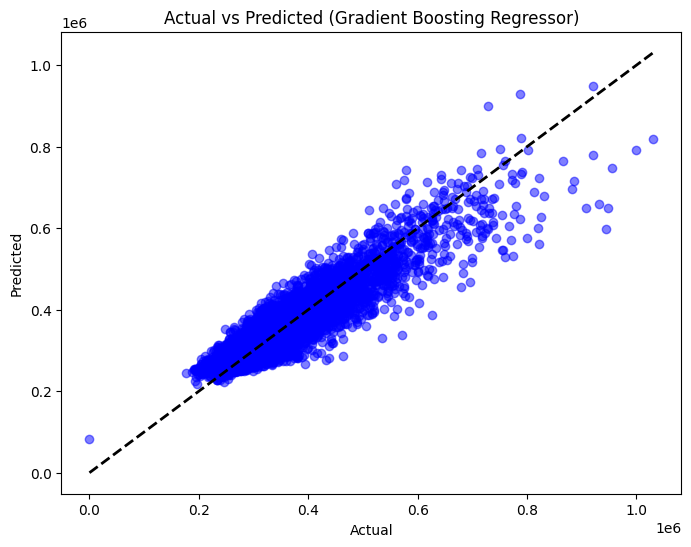

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Gradient Boosting Regressor
gbr = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Fit the model on training data
gbr.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred = gbr.predict(X_train)
y_test_pred = gbr.predict(X_test)

# Print model performance
print("### Gradient Boosting Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Gradient Boosting Regressor)')
plt.show()

**Interpretation:**

The Gradient Boosting Regressor shows strong performance with an R² of 0.87 for both training and test sets, indicating good generalization. The MAE values (around 21,000) and the scatter plot demonstrate that the model makes reasonable predictions but could benefit from further tuning to reduce some variance at higher values.

**Tuning for gradient boosting regressor**

Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Score (negative MSE): -827798171.3886786

### Gradient Boosting Regressor Model Performance (Training Set) ###

R²: 0.9114902354422445
Mean Absolute Error (MAE): 17775.392018013023
Mean Squared Error (MSE): 633977366.4577065

### Gradient Boosting Regressor Model Performance (Test Set) ###

R²: 0.890795575508563
Mean Absolute Error (MAE): 19040.41813820803
Mean Squared Error (MSE): 784518898.3717862


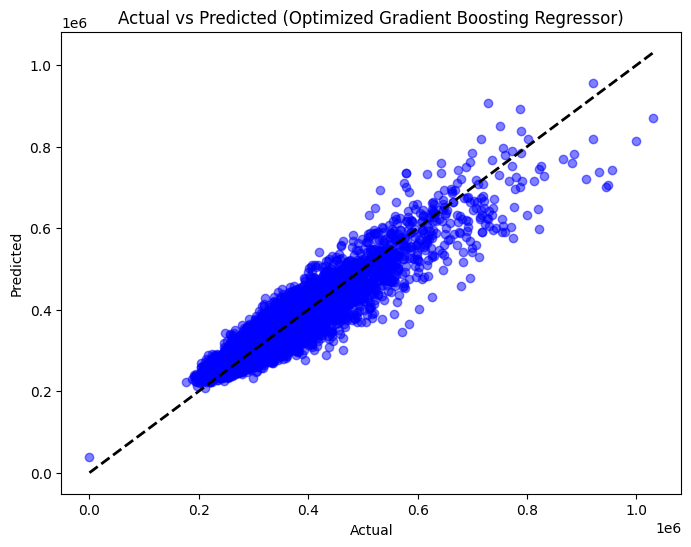

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Define a reduced parameter grid to speed up GridSearchCV
param_grid = {
    'n_estimators': [50, 100],              # Reduced number of estimators to 2 values
    'learning_rate': [0.05, 0.1],           # Focus on fewer learning rates
    'max_depth': [3, 5],                    # Reduced max depth to 2 values
    'min_samples_split': [5, 10],           # Reduced options for min_samples_split
    'min_samples_leaf': [2, 4]              # Reduced options for min_samples_leaf
}

# Initialize the GradientBoostingRegressor
gbr = GradientBoostingRegressor(random_state=42)

# Set up GridSearchCV with reduced cross-validation folds and fewer parameters
grid_search = GridSearchCV(estimator=gbr, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit GridSearchCV to the training data (with reduced parameter grid and cv)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_gbr = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred = best_gbr.predict(X_train)
y_test_pred = best_gbr.predict(X_test)

# Print model performance for the training set
print("\n### Gradient Boosting Regressor Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

# Print model performance for the test set
print("\n### Gradient Boosting Regressor Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Gradient Boosting Regressor)')
plt.show()


**Interpretation:**

The Optimized Gradient Boosting Regressor demonstrates improved performance, with an R² of 0.91 for the training set and 0.89 for the test set, indicating strong model fit. The MAE and MSE metrics reflect lower prediction errors compared to the untuned version. The scatter plot shows that the model captures most trends well, though there remains some variance in higher values.

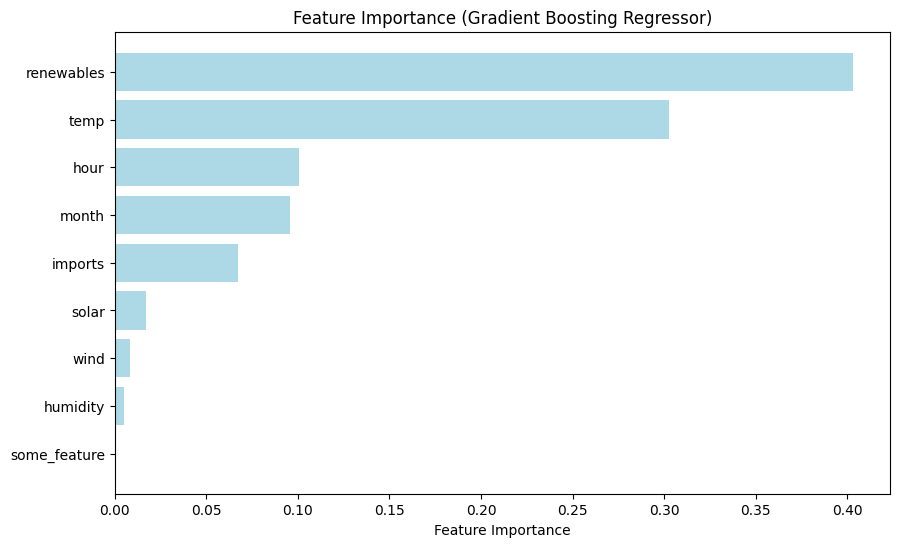

In [ ]:
# Get feature importances from the Gradient Boosting Regressor
importances = best_gbr.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances)), importances[indices], align='center', color='lightblue')
plt.yticks(range(len(importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Gradient Boosting Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


**Interpretation:**

The Gradient Boosting Regressor shows that renewables and temperature are the most important features, followed by hour, month, and imports. Other features like solar, wind, and humidity have lesser influence on the model's predictions.

###XGBoost

In [ ]:
!pip install xgboost

### XGBoost Regressor Model Performance ###

Training Performance:
R²: 0.8741393411440065
Mean Absolute Error (MAE): 20838.286623093452
Mean Squared Error (MSE): 901514193.8388854

Test Performance:
R²: 0.8678056153755033
Mean Absolute Error (MAE): 21138.218249307447
Mean Squared Error (MSE): 949677574.6909271


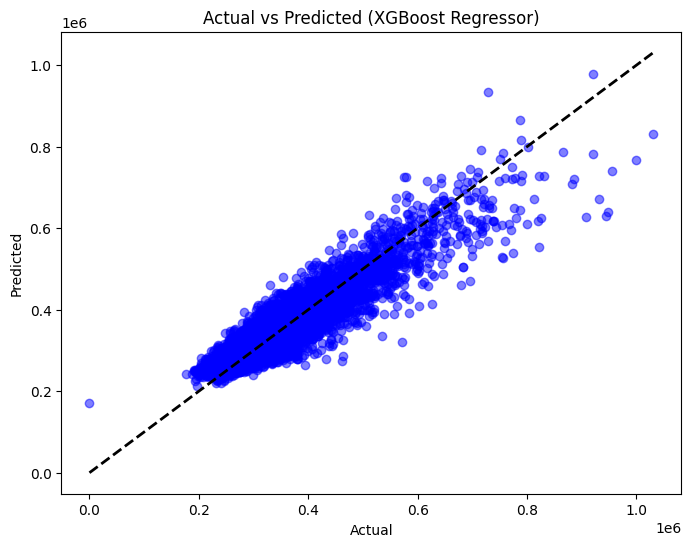

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the XGBoost Regressor
xgb_reg = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Fit the model on training data
xgb_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred = xgb_reg.predict(X_train)
y_test_pred = xgb_reg.predict(X_test)

# Print model performance
print("### XGBoost Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (XGBoost Regressor)')
plt.show()

**Interpretation:**

The XGBoost Regressor model performs reasonably well, with R² scores of 0.87 on both training and test sets, indicating good predictive power. The MAE is around 20,800 for training and 21,100 for test data, showing consistency in error magnitude. The MSE also supports this, with close values between training and test, indicating the model is generalizing well without overfitting. The scatter plot of actual vs. predicted values shows that the model generally follows the expected trend, with most points aligning with the ideal line.

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best Parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200, 'subsample': 0.8}
Best Score (negative MSE): -730467196.695728

### XGBoost Regressor Model Performance (Training Set) ###

R²: 0.9578272563227148
Mean Absolute Error (MAE): 12908.140857673301
Mean Squared Error (MSE): 302074749.67775595

### XGBoost Regressor Model Performance (Test Set) ###

R²: 0.9087437013295807
Mean Absolute Error (MAE): 17441.628402207436
Mean Squared Error (MSE): 655580497.180476


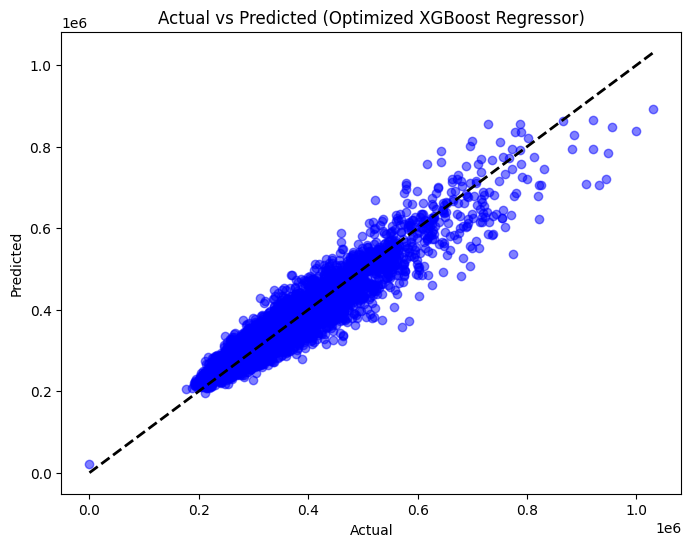

In [ ]:
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Define the parameter grid for GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# Initialize the XGBoost Regressor
xgb_reg = XGBRegressor(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=xgb_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=5, n_jobs=-1, verbose=2)

# Fit GridSearchCV to the training data
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_xgb_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred = best_xgb_reg.predict(X_train)
y_test_pred = best_xgb_reg.predict(X_test)

# Print model performance for the training set
print("\n### XGBoost Regressor Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

# Print model performance for the test set
print("\n### XGBoost Regressor Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized XGBoost Regressor)')
plt.show()


**interpretation:**

The Optimized XGBoost Regressor shows significant improvement compared to the non-optimized model:

- **Training Performance:** The model achieves a high R² of 0.96, indicating that it explains 96% of the variance in the training data. The MAE and MSE are reasonably low at 12,908 and 302 million, respectively, which indicates good accuracy in predictions.

- **Test Performance**: The R² on the test set is 0.91, suggesting strong generalization and high predictive power. The MAE of 17,442 and MSE of 656 million are comparable to the training values, confirming that the model does not overfit significantly.

The scatter plot of actual vs. predicted values aligns well with the ideal line, demonstrating that the model captures the underlying data patterns effectively.

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Initialize the LIME explainer for the optimized XGBoost Regressor
explainer_xgb_tuned = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X.columns,  # Ensure this matches the original feature names used for training
    mode='regression'
)

# Choose a random instance from the test set to explain (modify index as needed)
instance_index_xgb_tuned = 5
instance_to_explain_xgb_tuned = X_test.iloc[instance_index_xgb_tuned].values.reshape(1, -1)

# Explain the prediction for the selected instance using LIME for the optimized XGBoost model
exp_xgb_tuned = explainer_xgb_tuned.explain_instance(
    data_row=X_test.iloc[instance_index_xgb_tuned],
    predict_fn=best_xgb_reg.predict  # Using the optimized XGBoost model
)

# Display the explanation in notebook or console
exp_xgb_tuned.show_in_notebook(show_table=True)


**Interpretation:**

This visualization is an interpretation of a predictive model's decision, with contributions from individual features shown on both positive and negative sides.

- **Positive Contributions**: Features such as month, solar, and wind contribute positively to the predicted value. Specifically, month (between 6 and 9) has the largest positive impact, while solar and wind also add significantly.
  
- **Negative Contributions**: Features like renewables, temperature, hour, and humidity contribute negatively, decreasing the predicted value. The largest negative impact is from renewables being below a certain threshold.

Overall, the prediction is influenced both by conditions like the month and solar being high (increasing the value) and low renewables, temperature, and hour values (decreasing the value). This balance between positive and negative contributions ultimately determines the final predicted outcome.

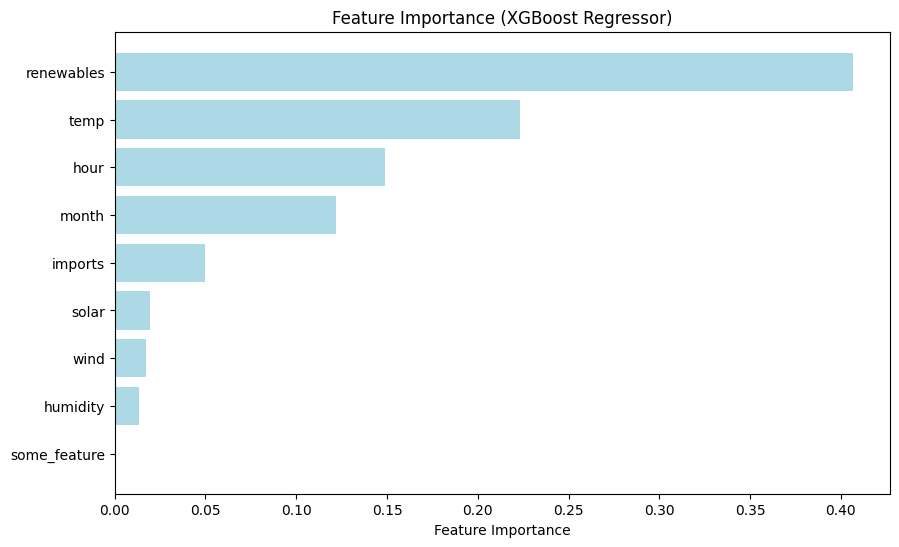

In [ ]:
# Get feature importances from the XGBoost Regressor
importances = best_xgb_reg.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances)), importances[indices], align='center', color='lightblue')
plt.yticks(range(len(importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (XGBoost Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


**Interpretation:**

This feature importance plot for the XGBoost Regressor highlights the key features influencing the model's predictions:

- renewables is the most significant feature, having the largest impact on the model's predictions.
- temp is also a crucial feature, though with slightly less influence compared to renewables.
- hour and month are moderately important, showing that time-related variables play a role in the prediction process.
- imports also contributes, while solar, wind, and humidity have minor influence.

Overall, the model depends primarily on renewables and temp, with time-based features (hour and month) providing additional predictive power.

###Extratrees and AdaBoost Regressor


Extra Trees Regressor - Training Data: Mean Squared Error: 0.0000, R² Score: 1.0000
Extra Trees Regressor - Test Data: Mean Squared Error: 671841806.9267, R² Score: 0.9046

AdaBoost Regressor - Training Data: Mean Squared Error: 3214575950.3965, R² Score: 0.5536
AdaBoost Regressor - Test Data: Mean Squared Error: 3233958559.3477, R² Score: 0.5406


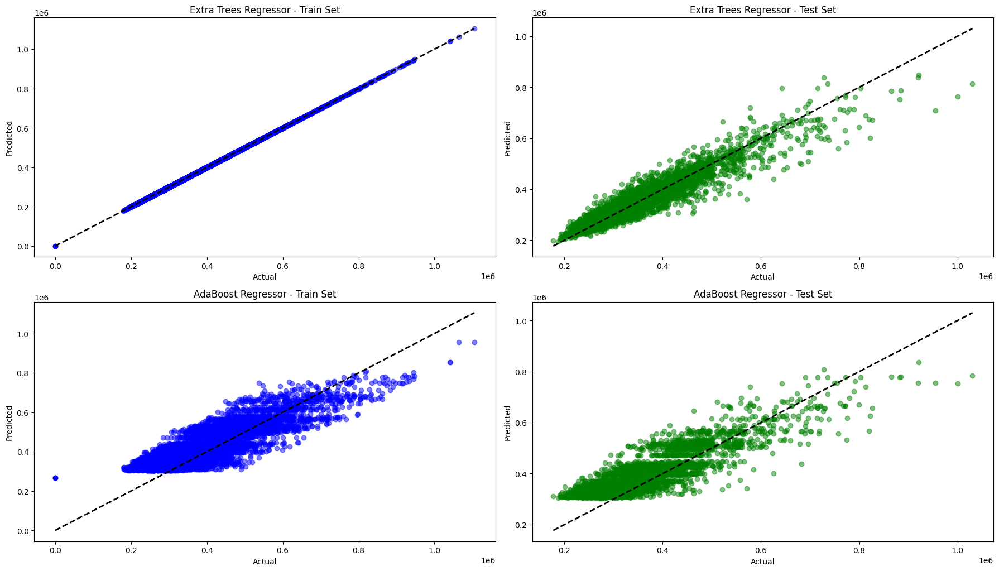

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Step 2: Data Preparation - Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a function to evaluate and display metrics
def evaluate_model(model, X, y):
    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, r2, y_pred

# Step 3: Initialize ensemble models (without hyperparameter tuning)
ensemble_models = {
    'Extra Trees Regressor': ExtraTreesRegressor(random_state=42),
    'AdaBoost Regressor': AdaBoostRegressor(random_state=42)
}

# Step 4: Train, evaluate, and plot results for each model
plt.figure(figsize=(18, 15))

for i, (model_name, model) in enumerate(ensemble_models.items(), 1):
    # Train model
    model.fit(X_train, y_train)

    # Evaluate on training data
    train_mse, train_r2, y_train_pred = evaluate_model(model, X_train, y_train)

    # Evaluate on testing data
    test_mse, test_r2, y_test_pred = evaluate_model(model, X_test, y_test)

    # Print model performance metrics
    print(f"\n{model_name} - Training Data: Mean Squared Error: {train_mse:.4f}, R² Score: {train_r2:.4f}")
    print(f"{model_name} - Test Data: Mean Squared Error: {test_mse:.4f}, R² Score: {test_r2:.4f}")

    # Plot actual vs predicted values for train and test sets
    plt.subplot(3, 2, 2*i - 1)
    plt.scatter(y_train, y_train_pred, color='blue', alpha=0.5)
    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Train Set')

    plt.subplot(3, 2, 2*i)
    plt.scatter(y_test, y_test_pred, color='green', alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Test Set')

plt.tight_layout()
plt.show()


**Interpretation:**

**Extra Trees Regressor**:
- **Training Data**: Perfect fit with R² = 1.0 and MSE = 0, indicating overfitting.
- **Test Data**: Good performance with R² = 0.9046 but worse MSE, showing overfitting signs.

**AdaBoost Regressor**:
- **Training and Test Data**: Similar performance with moderate fit (R² ≈ 0.54) and high MSE, suggesting the model struggles with complexity.

**Tuning extratree regressor and AdaBoost Regressor**

Tuning Extra Trees Regressor...
Fitting 3 folds for each of 5 candidates, totalling 15 fits

Extra Trees Regressor - Best Parameters: {'n_estimators': 100, 'min_samples_split': 5, 'max_depth': None}
Extra Trees Regressor - Training Data: Mean Squared Error: 56390998.4344, R² Score: 0.9922
Extra Trees Regressor - Test Data: Mean Squared Error: 672425141.8012, R² Score: 0.9045
Tuning AdaBoost Regressor...
Fitting 3 folds for each of 5 candidates, totalling 15 fits

AdaBoost Regressor - Best Parameters: {'n_estimators': 100, 'loss': 'linear', 'learning_rate': 0.1}
AdaBoost Regressor - Training Data: Mean Squared Error: 2026159881.5312, R² Score: 0.7186
AdaBoost Regressor - Test Data: Mean Squared Error: 2022228768.4061, R² Score: 0.7127


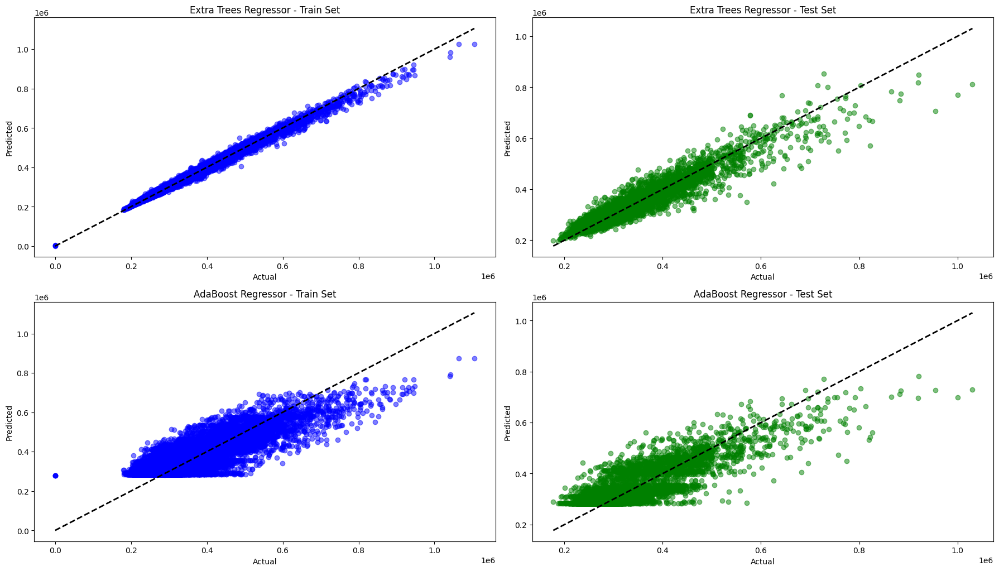

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostRegressor
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Step 2: Data Preparation - Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a function to evaluate and display metrics
def evaluate_model(model, X, y):
    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, r2, y_pred

# Hyperparameter grids for tuning each model (reduced for quicker execution)
param_grids = {
    'Extra Trees Regressor': {
        'n_estimators': [50, 100],
        'max_depth': [10, None],
        'min_samples_split': [2, 5]
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100],
        'learning_rate': [0.01, 0.1],
        'loss': ['linear', 'square']
    }
}

# Step 3: Initialize models for tuning and plotting
tuned_models = {}
plt.figure(figsize=(18, 15))

for i, (model_name, model) in enumerate([
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]):
    print(f"Tuning {model_name}...")

    # Randomized search with cross-validation (reduced n_iter for faster execution)
    randomized_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grids[model_name],
        n_iter=5,  # Reduced number of random combinations
        cv=3,  # 3-fold cross-validation
        verbose=1,
        random_state=42,
        n_jobs=-1  # Use all available cores
    )

    # Fit the randomized search
    randomized_search.fit(X_train, y_train)

    # Get the best model after tuning
    best_model = randomized_search.best_estimator_
    tuned_models[model_name] = best_model

    # Step 4: Evaluate the best model on both training and test sets
    train_mse, train_r2, y_train_pred = evaluate_model(best_model, X_train, y_train)
    test_mse, test_r2, y_test_pred = evaluate_model(best_model, X_test, y_test)

    # Print model performance metrics
    print(f"\n{model_name} - Best Parameters: {randomized_search.best_params_}")
    print(f"{model_name} - Training Data: Mean Squared Error: {train_mse:.4f}, R² Score: {train_r2:.4f}")
    print(f"{model_name} - Test Data: Mean Squared Error: {test_mse:.4f}, R² Score: {test_r2:.4f}")

    # Plot actual vs predicted values for train and test sets
    plt.subplot(3, 2, 2*i + 1)
    plt.scatter(y_train, y_train_pred, color='blue', alpha=0.5)
    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Train Set')

    plt.subplot(3, 2, 2*i + 2)
    plt.scatter(y_test, y_test_pred, color='green', alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Test Set')

plt.tight_layout()
plt.show()


**Interpretation:**

**Extra Trees Regressor**:
- **Training Data**: Very high fit with R² = 0.9922, indicating it captures most variance but might overfit.
- **Test Data**: Good performance (R² = 0.9045), indicating strong generalizability with some signs of overfitting.

**AdaBoost Regressor**:
- **Training Data**: Moderate fit (R² = 0.7186), indicating a balanced approach to the data.
- **Test Data**: Similar performance (R² = 0.7127), suggesting consistency between training and generalizability but not as accurate as Extra Trees.

##Research Question 2

How can the risk of consecutive days with low renewable energy generation
be effectively predicted based on weather patterns, and what measures can be implemented to
maintain reliability during such events?


In [ ]:
data_final['combined_renewables'] = data_final['solar'] + data_final['renewables'] + data_final['wind']


In [ ]:
features_q2 = ['temp', 'humidity', 'windspeed', 'solarenergy', 'cloudcover', 'large hydro', 'imports','hour','month']
target_q2 = 'combined_renewables'  # Target variable for predicting renewable energy generation

X_q2 = data_final[features_q2]
y_q2 = data_final[target_q2]

###Linear Regression


### Linear Regression Model Performance for Question 2 ###
Training Data - Mean Squared Error (MSE): 10338052280.1086, R² Score: 0.6451
Test Data - Mean Squared Error (MSE): 10256835737.0424, R² Score: 0.6451


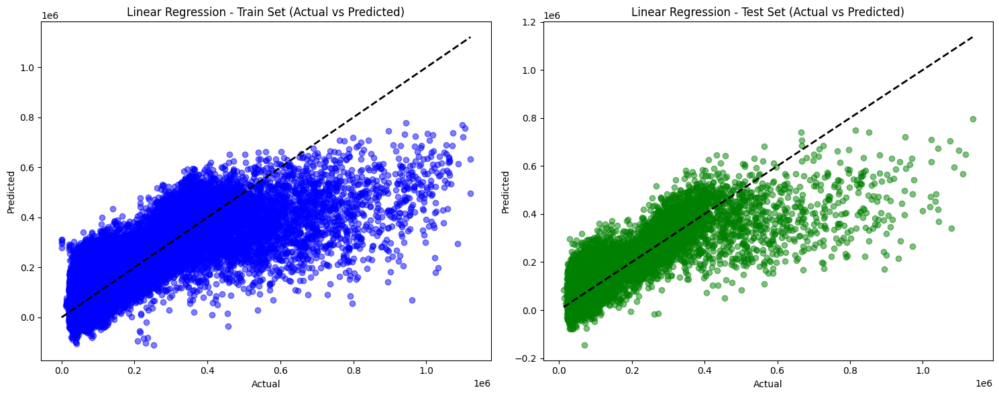

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

# Assuming X_q2 and y_q2 are defined earlier in your code

# Step 1: Train-test Split for Linear Regression
X_train_q2, X_test_q2, y_train_q2, y_test_q2 = train_test_split(X_q2, y_q2, test_size=0.2, random_state=42)

# Step 2: Model Training - Linear Regression
linear_model_q2 = LinearRegression()
linear_model_q2.fit(X_train_q2, y_train_q2)

# Step 3: Model Evaluation on Training Data
y_train_pred_q2 = linear_model_q2.predict(X_train_q2)
train_q2_mse = mean_squared_error(y_train_q2, y_train_pred_q2)
train_q2_r2 = r2_score(y_train_q2, y_train_pred_q2)

# Step 4: Model Evaluation on Test Data
y_test_pred_q2 = linear_model_q2.predict(X_test_q2)
test_q2_mse = mean_squared_error(y_test_q2, y_test_pred_q2)
test_q2_r2 = r2_score(y_test_q2, y_test_pred_q2)

# Display evaluation metrics for Linear Regression model (Train and Test)
print("\n### Linear Regression Model Performance for Question 2 ###")
print(f"Training Data - Mean Squared Error (MSE): {train_q2_mse:.4f}, R² Score: {train_q2_r2:.4f}")
print(f"Test Data - Mean Squared Error (MSE): {test_q2_mse:.4f}, R² Score: {test_q2_r2:.4f}")

# Step 5: Plotting Actual vs Predicted for Train and Test Sets
plt.figure(figsize=(15, 6))

# Plot for Training Data
plt.subplot(1, 2, 1)
plt.scatter(y_train_q2, y_train_pred_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Linear Regression - Train Set (Actual vs Predicted)')

# Plot for Test Data
plt.subplot(1, 2, 2)
plt.scatter(y_test_q2, y_test_pred_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Linear Regression - Test Set (Actual vs Predicted)')

plt.tight_layout()
plt.show()


**interpretation:**

The linear regression model shows moderate performance, with an R² score of 0.6451 on both the training and test datasets, indicating that around 64.5% of the variance in the data is explained by the model. The high mean squared errors (MSE) indicate that there is considerable error in predictions, which means the model may struggle to capture the complexities of the data.

###Reidge and Lasso Regression

In [ ]:
from sklearn.linear_model import Ridge, Lasso

# Step 1: Train Ridge Regression Model
ridge_model_q2 = Ridge(alpha=1.0)
ridge_model_q2.fit(X_train_q2, y_train_q2)

# Step 2: Train Lasso Regression Model
lasso_model_q2 = Lasso(alpha=1.0)
lasso_model_q2.fit(X_train_q2, y_train_q2)

# Step 3: Evaluation - Ridge Regression
y_train_pred_ridge_q2 = ridge_model_q2.predict(X_train_q2)
y_test_pred_ridge_q2 = ridge_model_q2.predict(X_test_q2)
train_ridge_q2_mse = mean_squared_error(y_train_q2, y_train_pred_ridge_q2)
train_ridge_q2_r2 = r2_score(y_train_q2, y_train_pred_ridge_q2)
test_ridge_q2_mse = mean_squared_error(y_test_q2, y_test_pred_ridge_q2)
test_ridge_q2_r2 = r2_score(y_test_q2, y_test_pred_ridge_q2)

# Step 4: Evaluation - Lasso Regression
y_train_pred_lasso_q2 = lasso_model_q2.predict(X_train_q2)
y_test_pred_lasso_q2 = lasso_model_q2.predict(X_test_q2)
train_lasso_q2_mse = mean_squared_error(y_train_q2, y_train_pred_lasso_q2)
train_lasso_q2_r2 = r2_score(y_train_q2, y_train_pred_lasso_q2)
test_lasso_q2_mse = mean_squared_error(y_test_q2, y_test_pred_lasso_q2)
test_lasso_q2_r2 = r2_score(y_test_q2, y_test_pred_lasso_q2)




### Ridge Regression Model Performance for Question 2 ###
Training Data - Mean Squared Error (MSE): 10338052280.6298, R² Score: 0.6451
Test Data - Mean Squared Error (MSE): 10256837714.1335, R² Score: 0.6451

### Lasso Regression Model Performance for Question 2 ###
Training Data - Mean Squared Error (MSE): 10338052282.0745, R² Score: 0.6451
Test Data - Mean Squared Error (MSE): 10256839877.1850, R² Score: 0.6451


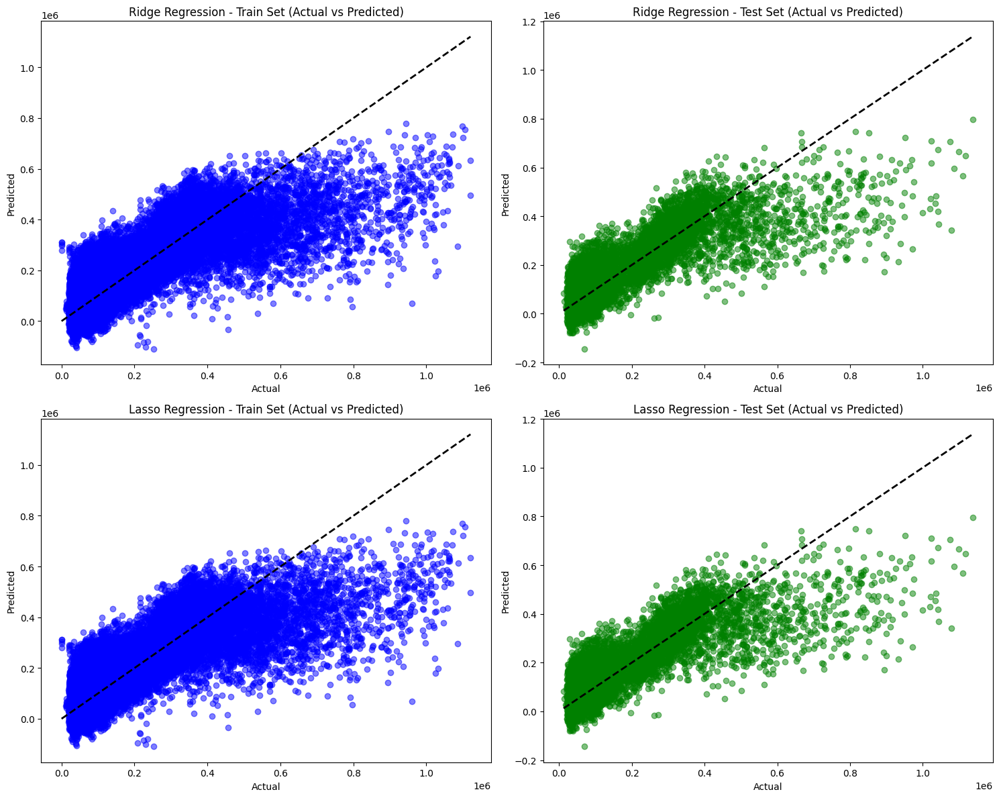

In [ ]:
import matplotlib.pyplot as plt

# Step 1: Display evaluation metrics for Ridge Regression model
print("\n### Ridge Regression Model Performance for Question 2 ###")
print(f"Training Data - Mean Squared Error (MSE): {train_ridge_q2_mse:.4f}, R² Score: {train_ridge_q2_r2:.4f}")
print(f"Test Data - Mean Squared Error (MSE): {test_ridge_q2_mse:.4f}, R² Score: {test_ridge_q2_r2:.4f}")

# Step 2: Display evaluation metrics for Lasso Regression model
print("\n### Lasso Regression Model Performance for Question 2 ###")
print(f"Training Data - Mean Squared Error (MSE): {train_lasso_q2_mse:.4f}, R² Score: {train_lasso_q2_r2:.4f}")
print(f"Test Data - Mean Squared Error (MSE): {test_lasso_q2_mse:.4f}, R² Score: {test_lasso_q2_r2:.4f}")

# Step 3: Plotting Actual vs Predicted for Ridge and Lasso Regression models
plt.figure(figsize=(15, 12))

# Ridge Regression - Training Data
plt.subplot(2, 2, 1)
plt.scatter(y_train_q2, y_train_pred_ridge_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Ridge Regression - Train Set (Actual vs Predicted)')

# Ridge Regression - Test Data
plt.subplot(2, 2, 2)
plt.scatter(y_test_q2, y_test_pred_ridge_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Ridge Regression - Test Set (Actual vs Predicted)')

# Lasso Regression - Training Data
plt.subplot(2, 2, 3)
plt.scatter(y_train_q2, y_train_pred_lasso_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Lasso Regression - Train Set (Actual vs Predicted)')

# Lasso Regression - Test Data
plt.subplot(2, 2, 4)
plt.scatter(y_test_q2, y_test_pred_lasso_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Lasso Regression - Test Set (Actual vs Predicted)')

plt.tight_layout()
plt.show()


**Interpretation:**

The Ridge and Lasso regression models show similar performance, with both models having an R² score of 0.6451 for the training and test datasets. This indicates that about 64.5% of the variance is explained by the models. However, the high mean squared errors (MSE) suggest that the models have difficulty accurately predicting the target, and they may not be capturing all the important relationships within the data.

###Random forest regressor

Random Forest Regressor - Train MSE: 459296223.1862084 Train R²: 0.9842327096791403
Random Forest Regressor - Test MSE: 3181255994.871597 Test R²: 0.8899200027242051


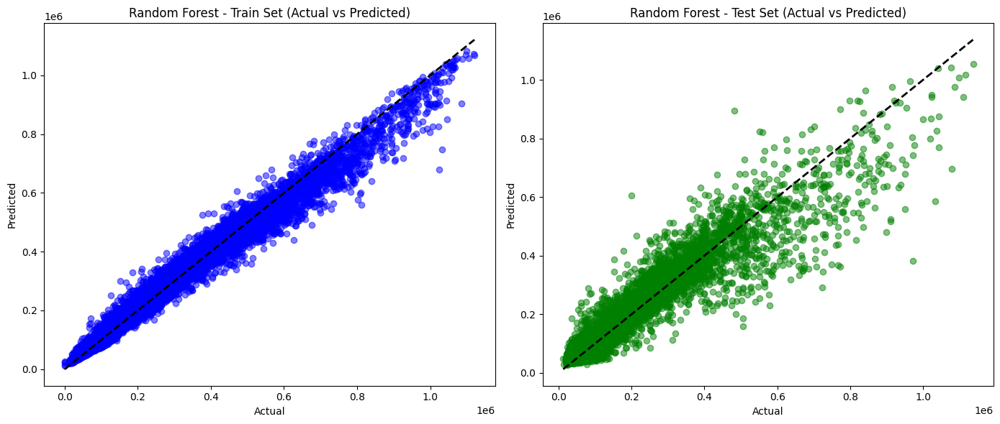

In [ ]:
import matplotlib.pyplot as plt

# Step 1: Model Training - Random Forest Regressor for Predicting Renewable Energy Generation
rf_regressor_q2 = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor_q2.fit(X_train_q2, y_train_q2)

# Step 2: Model Evaluation on Training Data
y_train_pred_rf_q2 = rf_regressor_q2.predict(X_train_q2)
train_rf_q2_mse = mean_squared_error(y_train_q2, y_train_pred_rf_q2)
train_rf_q2_r2 = r2_score(y_train_q2, y_train_pred_rf_q2)
print("Random Forest Regressor - Train MSE:", train_rf_q2_mse, "Train R²:", train_rf_q2_r2)

# Step 3: Model Evaluation on Test Data
y_test_pred_rf_q2 = rf_regressor_q2.predict(X_test_q2)
test_rf_q2_mse = mean_squared_error(y_test_q2, y_test_pred_rf_q2)
test_rf_q2_r2 = r2_score(y_test_q2, y_test_pred_rf_q2)
print("Random Forest Regressor - Test MSE:", test_rf_q2_mse, "Test R²:", test_rf_q2_r2)

# Step 4: Plotting Actual vs Predicted for Training and Test Data
plt.figure(figsize=(14, 6))

# Training Set Plot
plt.subplot(1, 2, 1)
plt.scatter(y_train_q2, y_train_pred_rf_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Random Forest - Train Set (Actual vs Predicted)')

# Test Set Plot
plt.subplot(1, 2, 2)
plt.scatter(y_test_q2, y_test_pred_rf_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Random Forest - Test Set (Actual vs Predicted)')

plt.tight_layout()
plt.show()


**Interpretation:**

The Random Forest Regressor model demonstrates strong performance, especially on the training data with an R² of 0.98, suggesting it fits the data very well. However, there is a slight decrease in performance on the test set with an R² of 0.89, indicating that the model still generalizes well but may have some overfitting. The relatively higher mean squared error (MSE) for the test set compared to the training set further supports this observation. Overall, the model performs effectively but could potentially be fine-tuned to address the overfitting.

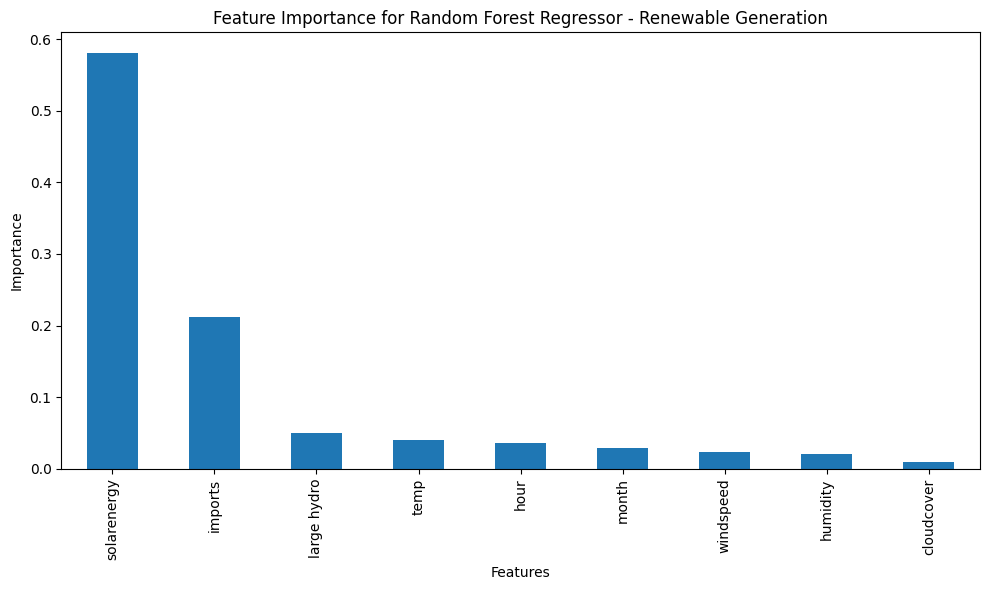

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Extract and plot feature importances
feature_importances_rf_q2 = pd.Series(rf_regressor_q2.feature_importances_, index=features_q2)
feature_importances_rf_q2.sort_values(ascending=False).plot(kind='bar', figsize=(10, 6))
plt.title('Feature Importance for Random Forest Regressor - Renewable Generation')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.tight_layout()
plt.show()


**Interpretation:**

The feature importance plot for the Random Forest Regressor indicates that "solar energy" is by far the most significant feature, contributing around 60% to the model's predictive power for renewable generation. The next most influential feature is "imports," accounting for approximately 20%. The rest of the features—such as "large hydro," "temp," "hour," "month," "windspeed," "humidity," and "cloudcover"—have comparatively minor contributions, indicating they have less impact on predicting renewable energy generation. This suggests that solar energy plays a dominant role in determining renewable output in the dataset used.

**Tuning random forest regressor**


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score

# Step 1: Define a further reduced hyperparameter grid for Random Forest Regressor
param_dist_rf_reduced = {
    'n_estimators': [100, 150],                       # Reduced number of trees to minimize training time
    'max_depth': [5, 10],                             # Limited max depth options for faster training
    'min_samples_split': [5],                         # Reduced options for splitting to reduce variability
    'min_samples_leaf': [2],                          # Reduced number of leaf nodes
    'max_features': ['sqrt']                          # Limited options for max features
}

# Step 2: Set up RandomizedSearchCV with further reduced parameters
random_search_rf_reduced = RandomizedSearchCV(
    RandomForestRegressor(random_state=42),
    param_distributions=param_dist_rf_reduced,
    n_iter=5,                                         # Reduced number of iterations for quicker tuning
    cv=2,                                             # Reduced number of cross-validation folds
    scoring='r2',
    random_state=42,
    n_jobs=-1                                         # Use all available processors for parallelization
)

# Step 3: Fit the model using RandomizedSearchCV (Reduced Parameters)
random_search_rf_reduced.fit(X_train_q2, y_train_q2)

# Step 4: Get the best parameters and evaluate the best model
best_params_rf_reduced = random_search_rf_reduced.best_params_
best_rf_model_reduced = random_search_rf_reduced.best_estimator_

print("Best Parameters for Random Forest Regressor (Reduced Search):", best_params_rf_reduced)

# Step 5: Evaluate the best Random Forest model on training data
y_train_pred_best_rf_reduced = best_rf_model_reduced.predict(X_train_q2)
train_best_rf_reduced_mse = mean_squared_error(y_train_q2, y_train_pred_best_rf_reduced)
train_best_rf_reduced_r2 = r2_score(y_train_q2, y_train_pred_best_rf_reduced)

print("Best Random Forest Model - Train MSE:", train_best_rf_reduced_mse, "Train R²:", train_best_rf_reduced_r2)

# Step 6: Evaluate the best Random Forest model on test data
y_test_pred_best_rf_reduced = best_rf_model_reduced.predict(X_test_q2)
test_best_rf_reduced_mse = mean_squared_error(y_test_q2, y_test_pred_best_rf_reduced)
test_best_rf_reduced_r2 = r2_score(y_test_q2, y_test_pred_best_rf_reduced)

print("Best Random Forest Model - Test MSE:", test_best_rf_reduced_mse, "Test R²:", test_best_rf_reduced_r2)


Best Parameters for Random Forest Regressor (Reduced Search): {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 10}
Best Random Forest Model - Train MSE: 3260309493.715279 Train R²: 0.8880760526035882
Best Random Forest Model - Test MSE: 4045637043.9320374 Test R²: 0.8600100980578683


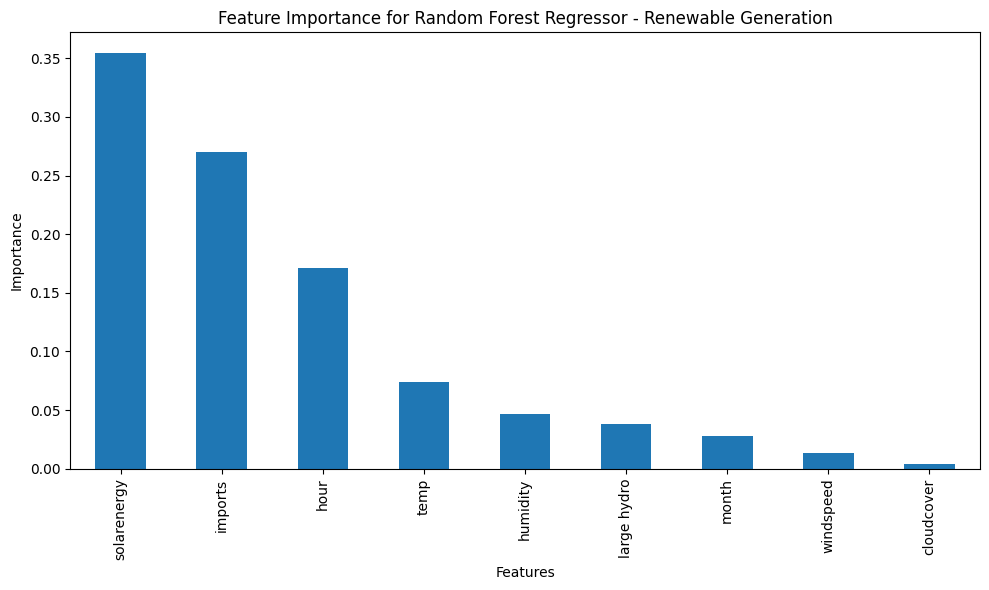

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Extract Feature Importances from the Tuned Random Forest Model
feature_importances_rf_q2 = pd.Series(best_rf_model_reduced.feature_importances_, index=features_q2)

# Step 2: Plot Feature Importances
plt.figure(figsize=(10, 6))
feature_importances_rf_q2.sort_values(ascending=False).plot(kind='bar')
plt.title('Feature Importance for Random Forest Regressor - Renewable Generation')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.tight_layout()
plt.show()




**Interpretation:**

The Random Forest Regressor model, after parameter tuning, performs well with a training R² of approximately 0.888 and a test R² of about 0.86, indicating a good fit. The most significant feature is "solar energy," with "imports" and "hour" also playing important roles in predicting renewable generation. Other features like "temp," "humidity," and "large hydro" have lower but still notable contributions, whereas "windspeed" and "cloudcover" are the least important. This implies that solar energy, imports, and the time of day are major factors influencing renewable energy output in this model.

In [ ]:
# LIME Explanation for Random Forest Regressor Model
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_q2.values,
                                                   feature_names=X_train_q2.columns,
                                                   mode='regression')

# Explain a single prediction
i = 10  # Index of the sample to explain
explanation = explainer.explain_instance(X_test_q2.iloc[i].to_numpy(), best_rf_model_reduced.predict, num_features=10)
explanation.show_in_notebook()  # or explanation.as_pyplot_figure()

**Interpretation:**

- **Negative Influences**: The most significant negative contributors to the predicted renewable generation are zero solar energy (`solarenergy = 0.00`) and late hours (`hour > 18`). Higher imports (`imports > 30368.99`) and lower wind speed (`windspeed <= 5.40`) also negatively affect the output.
  
- **Positive Influences**: The strongest positive impact comes from high "large hydro" generation (`large hydro = 45889.97`). Other positive factors include moderate values for `humidity`, certain months (`month <= 6.00`), and specific temperature ranges.

The **predicted value** for this observation is approximately **93,454**.

###Gradient boosting, XGboost, Extratrees, Adaboost, Bagging

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# Step 2: Train-test Split for Ensemble Models
X_train_q2, X_test_q2, y_train_q2, y_test_q2 = train_test_split(X_q2, y_q2, test_size=0.2, random_state=42)

# Define a function to evaluate and display metrics
def evaluate_model(model, X_train, y_train, X_test, y_test):
    # Training predictions
    y_train_pred = model.predict(X_train)
    train_mse = mean_squared_error(y_train, y_train_pred)
    train_r2 = r2_score(y_train, y_train_pred)

    # Testing predictions
    y_test_pred = model.predict(X_test)
    test_mse = mean_squared_error(y_test, y_test_pred)
    test_r2 = r2_score(y_test, y_test_pred)

    return (train_mse, train_r2), (test_mse, test_r2)

# Step 3: Initialize ensemble models
ensemble_models_q2 = {
    'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    'XGBoost': XGBRegressor(random_state=42),
    'Bagging Regressor': BaggingRegressor(random_state=42),
    'Extra Trees Regressor': ExtraTreesRegressor(random_state=42),
    'AdaBoost Regressor': AdaBoostRegressor(random_state=42)
}

# Step 4: Train and evaluate each ensemble model
for model_name, model in ensemble_models_q2.items():
    # Train the model
    model.fit(X_train_q2, y_train_q2)

    # Evaluate on training and test data
    (train_mse, train_r2), (test_mse, test_r2) = evaluate_model(model, X_train_q2, y_train_q2, X_test_q2, y_test_q2)

    # Display the evaluation results
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R^2: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R^2: {test_r2:.4f}\n")

Gradient Boosting - Training MSE: 4509404239.0902, R^2: 0.8452
Gradient Boosting - Testing MSE: 4720878490.1579, R^2: 0.8366

XGBoost - Training MSE: 1681935338.7638, R^2: 0.9423
XGBoost - Testing MSE: 3212921495.7825, R^2: 0.8888

Bagging Regressor - Training MSE: 663844688.0811, R^2: 0.9772
Bagging Regressor - Testing MSE: 3534934564.4514, R^2: 0.8777

Extra Trees Regressor - Training MSE: 0.0000, R^2: 1.0000
Extra Trees Regressor - Testing MSE: 2850939158.3789, R^2: 0.9013

AdaBoost Regressor - Training MSE: 11380356493.5348, R^2: 0.6093
AdaBoost Regressor - Testing MSE: 11496977800.4558, R^2: 0.6022



Gradient Boosting - Training MSE: 4509404239.0902, R^2: 0.8452
Gradient Boosting - Testing MSE: 4720878490.1579, R^2: 0.8366



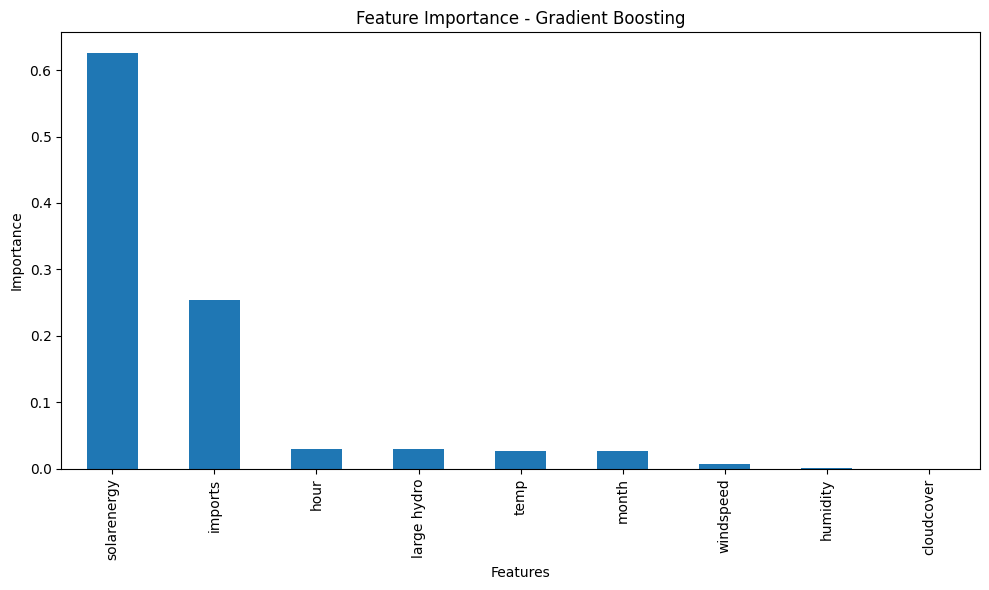

XGBoost - Training MSE: 1681935338.7638, R^2: 0.9423
XGBoost - Testing MSE: 3212921495.7825, R^2: 0.8888



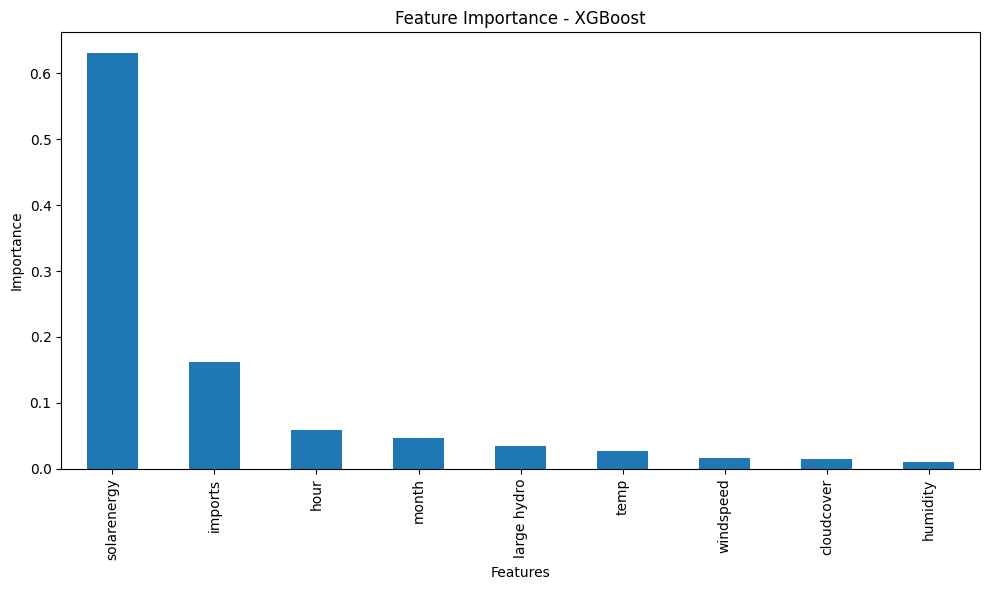

Bagging Regressor - Training MSE: 663844688.0811, R^2: 0.9772
Bagging Regressor - Testing MSE: 3534934564.4514, R^2: 0.8777



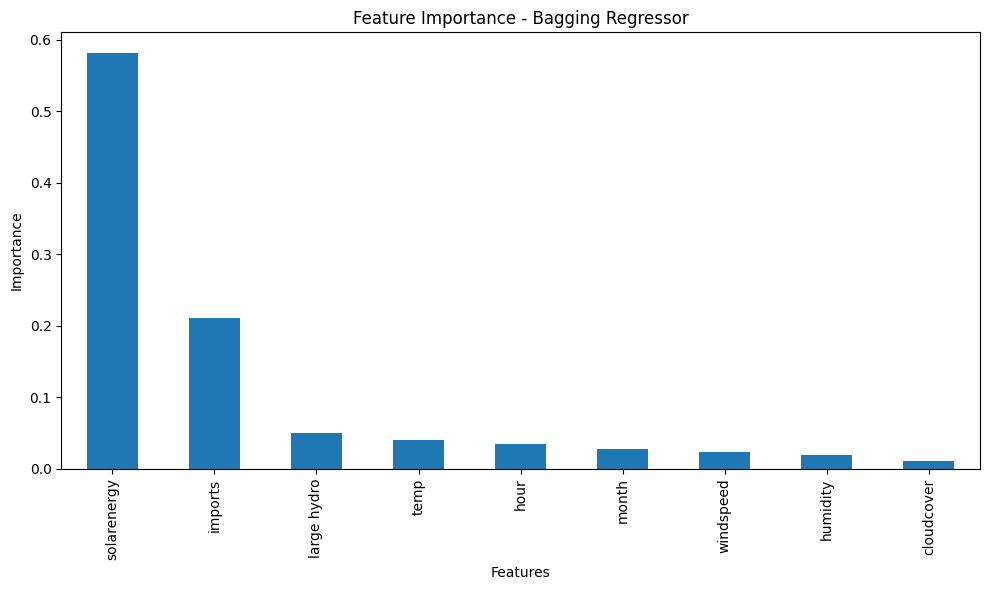

Extra Trees Regressor - Training MSE: 0.0000, R^2: 1.0000
Extra Trees Regressor - Testing MSE: 2850939158.3789, R^2: 0.9013



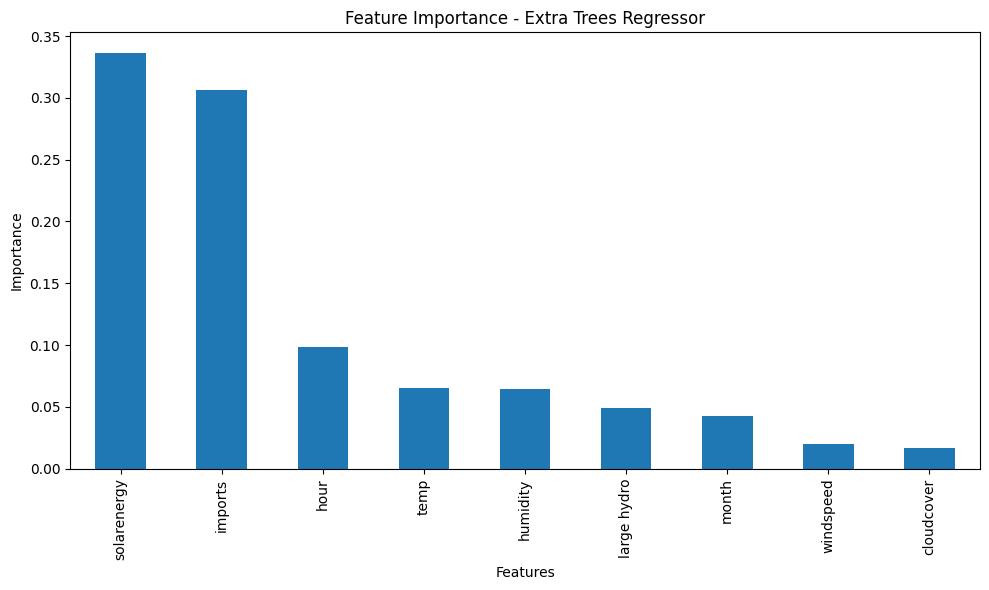

AdaBoost Regressor - Training MSE: 11380356493.5348, R^2: 0.6093
AdaBoost Regressor - Testing MSE: 11496977800.4558, R^2: 0.6022



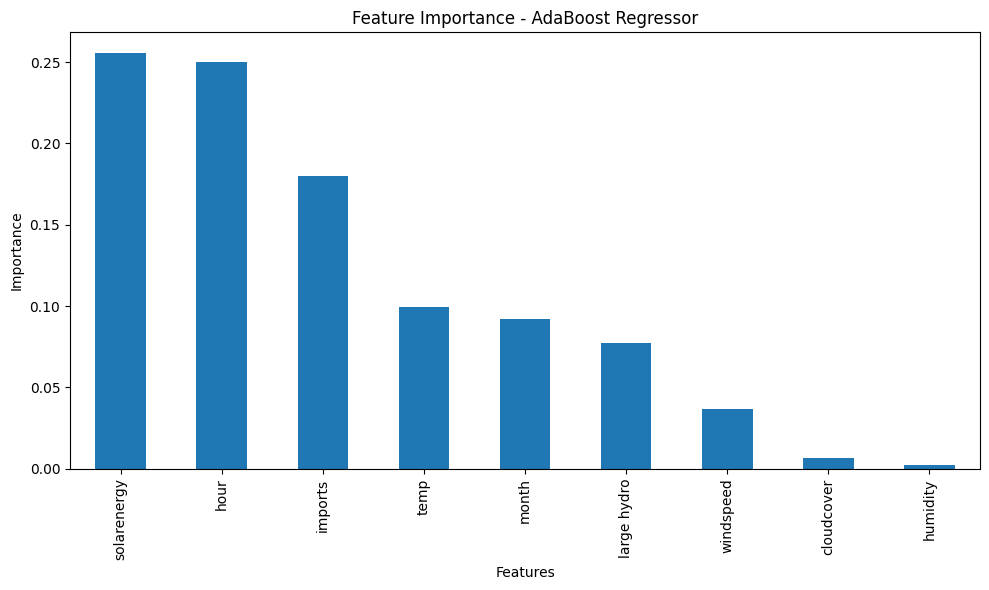

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Train and evaluate each ensemble model and calculate feature importance where applicable
for model_name, model in ensemble_models_q2.items():
    # Train the model
    model.fit(X_train_q2, y_train_q2)

    # Evaluate on training and test data
    (train_mse, train_r2), (test_mse, test_r2) = evaluate_model(model, X_train_q2, y_train_q2, X_test_q2, y_test_q2)

    # Display the evaluation results
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R^2: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R^2: {test_r2:.4f}\n")

    # Feature importance extraction and plotting for models that support it
    if model_name in ['Gradient Boosting', 'XGBoost', 'Extra Trees Regressor', 'AdaBoost Regressor']:
        # Extract feature importances
        feature_importances = model.feature_importances_

        # Convert to Pandas Series for easy plotting (assuming X_train_q2 is a DataFrame)
        feature_importance_series = pd.Series(feature_importances, index=X_train_q2.columns)

        # Plot feature importances
        plt.figure(figsize=(10, 6))
        feature_importance_series.sort_values(ascending=False).plot(kind='bar')
        plt.title(f'Feature Importance - {model_name}')
        plt.xlabel('Features')
        plt.ylabel('Importance')
        plt.tight_layout()
        plt.show()

    elif model_name == 'Bagging Regressor':
        # Bagging Regressor: Access individual estimators and aggregate their feature importance
        if hasattr(model, 'estimators_'):
            # Collect feature importances from each individual estimator (if available)
            importances = []
            for estimator in model.estimators_:
                if hasattr(estimator, 'feature_importances_'):
                    importances.append(estimator.feature_importances_)

            if importances:
                # Compute the average feature importance across all estimators
                avg_importances = pd.Series(np.mean(importances, axis=0), index=X_train_q2.columns)

                # Plot the averaged feature importances
                plt.figure(figsize=(10, 6))
                avg_importances.sort_values(ascending=False).plot(kind='bar')
                plt.title(f'Feature Importance - {model_name}')
                plt.xlabel('Features')
                plt.ylabel('Importance')
                plt.tight_layout()
                plt.show()


**Interpretation:**

**Feature Importance Across Models:**
1. **Solar Energy** and **Imports** consistently appear as the most influential features across Gradient Boosting, XGBoost, Bagging, Extra Trees, and AdaBoost regressors.
2. **Hour**, **Temperature**, **Large Hydro**, and **Humidity** have varying levels of importance depending on the model but generally contribute less than Solar and Imports.

**Model Performance Summary:**
- **Gradient Boosting**:
  - Training R²: 0.8452, Testing R²: 0.8366. Moderate training performance, but a slight drop in the testing set.
  
- **XGBoost**:
  - Training R²: 0.9423, Testing R²: 0.8888. High training and good testing performance, demonstrating strong generalization.
  
- **Bagging Regressor**:
  - Training R²: 0.9772, Testing R²: 0.8777. Very strong fit on training, slight overfitting seen in testing performance.
  
- **Extra Trees Regressor**:
  - Training R²: 1.0000, Testing R²: 0.9013. Perfect training fit indicates overfitting, though testing R² is quite strong.
  
- **AdaBoost Regressor**:
  - Training R²: 0.6093, Testing R²: 0.6022. Lower scores indicate limited ability to capture complex relationships.

**Takeaway:**
- **Solar Energy** and **Imports** are the most critical features for predicting renewable generation.
- **XGBoost** and **Bagging Regressor** provide strong performance while managing complexity effectively.
- **Extra Trees** shows significant overfitting, whereas **AdaBoost** struggles to capture non-linearity effectively.



####lime analysis before tuning

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Define LIME Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_q2.values,  # Training data values
    feature_names=X_train_q2.columns,  # Column names
    mode='regression',  # Because we are dealing with regression
    random_state=42
)

# Select an instance to explain (for example, the 10th sample from the test set)
i = 10
instance = X_test_q2.iloc[i].to_numpy()

# Apply LIME to each model and generate explanations
for model_name, model in ensemble_models_q2.items():
    if model_name in ['Gradient Boosting', 'XGBoost', 'Extra Trees Regressor', 'AdaBoost Regressor', 'Bagging Regressor']:
        # Make predictions using the specific model
        model_predict_function = model.predict

        # Generate LIME explanation for the selected instance
        explanation = explainer.explain_instance(instance, model_predict_function, num_features=10)

        # Display the explanation as a chart
        print(f"LIME Explanation for {model_name}:")
        explanation.show_in_notebook()  # or explanation.as_pyplot_figure()


LIME Explanation for Gradient Boosting:


LIME Explanation for XGBoost:


LIME Explanation for Bagging Regressor:


LIME Explanation for Extra Trees Regressor:


LIME Explanation for AdaBoost Regressor:


**Interpretation:**

**Common Negative Influences:**
1. **Solarenergy (<= 0.00)**: Consistently, the lack of solar energy negatively impacts predictions across all models.
2. **Hour (> 18.00)**: Higher hours tend to reduce predicted output in all models.
3. **Imports**: When imports exceed 30,368.99, it negatively influences the predictions.
4. **Humidity and Windspeed**: Specific thresholds for these features have a negative influence, generally indicating less favorable renewable energy conditions.

**Common Positive Influences:**
1. **Large Hydro (> 32,571.28)**: Significant positive influence, contributing heavily to the predictions in all models.
2. **Month (3.00 < month <= 6.00)**: The early months of the year contribute positively, indicating higher renewable energy predictions.
3. **Temperature and Cloudcover**: Certain thresholds contribute positively, suggesting better conditions for renewable generation.

**Key Observations Across Models:**
- **Positive Influence of Large Hydro**: This feature was consistently a major contributor to increasing the predictions across all models.
- **Solar Energy’s Negative Influence**: The lack of solar energy (i.e., solarenergy <= 0) showed a consistent negative effect on the predicted output.
- **Feature Interactions**: Imports and windspeed also had mixed influences based on their thresholds, either contributing positively or negatively.



####tuning the models

Tuning Gradient Boosting...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
Gradient Boosting - Best Parameters: {'n_estimators': 100, 'min_samples_split': 5, 'max_depth': 3, 'learning_rate': 0.1}
Gradient Boosting - Training MSE: 4509423745.2517, R²: 0.8452
Gradient Boosting - Testing MSE: 4720984166.5263, R²: 0.8366



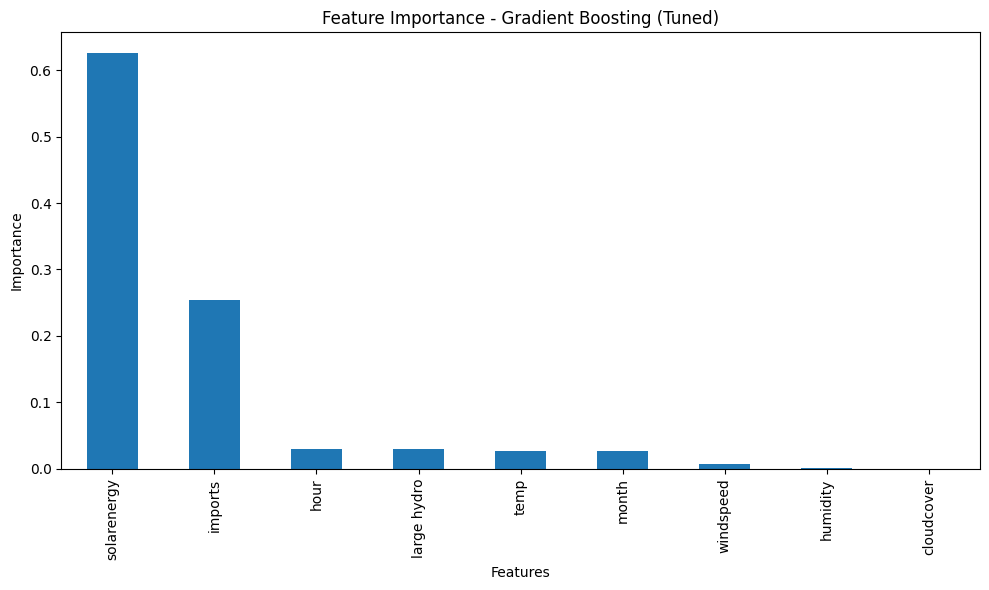

Tuning XGBoost...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
XGBoost - Best Parameters: {'subsample': 0.7, 'n_estimators': 100, 'max_depth': 3, 'learning_rate': 0.1}
XGBoost - Training MSE: 4510194274.4868, R²: 0.8452
XGBoost - Testing MSE: 4691777385.6582, R²: 0.8377



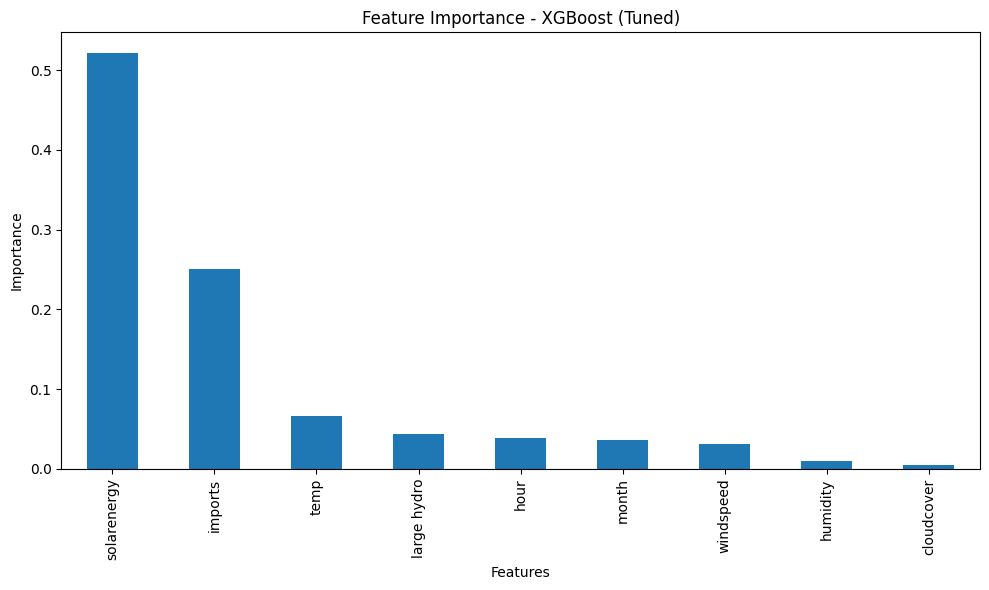

Tuning Bagging Regressor...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
Bagging Regressor - Best Parameters: {'n_estimators': 50, 'max_samples': 0.7, 'max_features': 0.7}
Bagging Regressor - Training MSE: 943904860.0349, R²: 0.9676
Bagging Regressor - Testing MSE: 3609417455.7833, R²: 0.8751

Tuning Extra Trees Regressor...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
Extra Trees Regressor - Best Parameters: {'n_estimators': 50, 'min_samples_split': 2, 'max_depth': None}
Extra Trees Regressor - Training MSE: 0.0000, R²: 1.0000
Extra Trees Regressor - Testing MSE: 2896352808.1904, R²: 0.8998



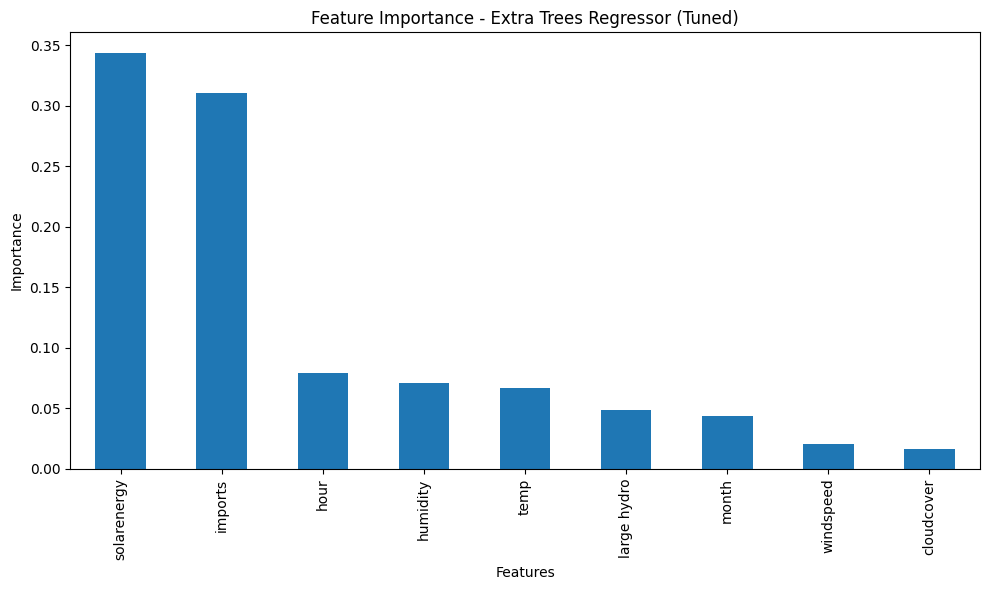

Tuning AdaBoost Regressor...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
AdaBoost Regressor - Best Parameters: {'n_estimators': 100, 'learning_rate': 0.01}
AdaBoost Regressor - Training MSE: 8227936143.9093, R²: 0.7175
AdaBoost Regressor - Testing MSE: 8331407210.1529, R²: 0.7117



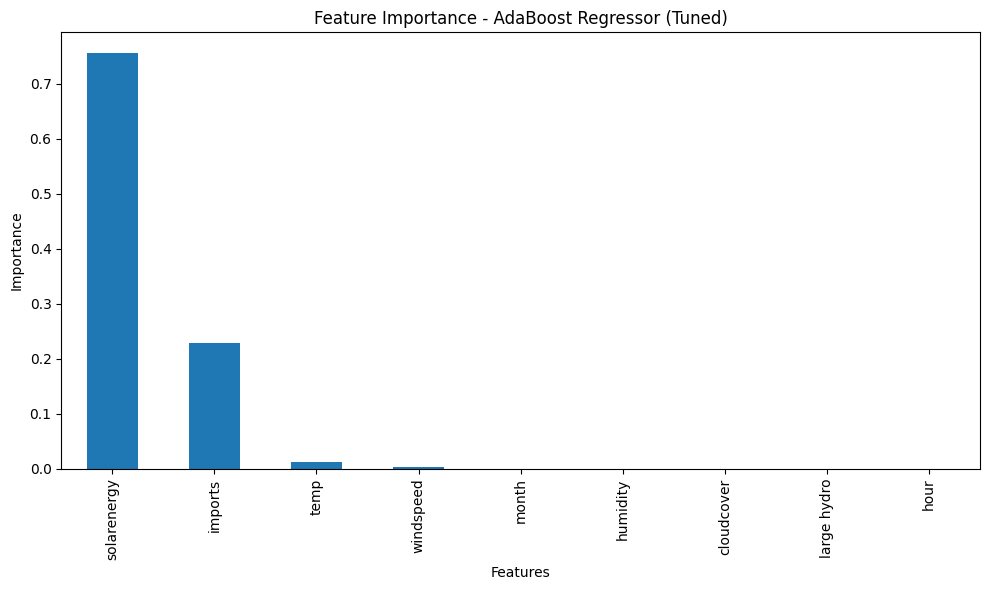

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.ensemble import GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score

# Define the hyperparameter grid for each model
param_grids_q2_reduced = {
    'Gradient Boosting': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'min_samples_split': [2, 5, 10],
    },
    'XGBoost': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'subsample': [0.7, 0.8, 1.0],
    },
    'Bagging Regressor': {
        'n_estimators': [10, 50, 100],
        'max_samples': [0.5, 0.7, 1.0],
        'max_features': [0.5, 0.7, 1.0],
    },
    'Extra Trees Regressor': {
        'n_estimators': [50, 100, 150],
        'max_depth': [None, 5, 10],
        'min_samples_split': [2, 5, 10],
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 0.2],
    },
}

# Iterate through each tuned model and plot feature importance if available
for model_name, model in [
    ('Gradient Boosting', GradientBoostingRegressor(random_state=42)),
    ('XGBoost', XGBRegressor(random_state=42)),
    ('Bagging Regressor', BaggingRegressor(random_state=42)),
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]:
    print(f"Tuning {model_name}...")

    # Randomized search with cross-validation (reduced parameters)
    randomized_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grids_q2_reduced[model_name],
        n_iter=5,  # Reduced number of iterations for faster tuning
        cv=2,  # Reduced cross-validation folds
        verbose=1,
        random_state=42,
        n_jobs=-1  # Use all available cores
    )

    # Fit the randomized search
    randomized_search.fit(X_train_q2, y_train_q2)

    # Get the best model after tuning
    best_model = randomized_search.best_estimator_

    # Evaluate on training and test data
    y_train_pred = best_model.predict(X_train_q2)
    y_test_pred = best_model.predict(X_test_q2)

    train_mse = mean_squared_error(y_train_q2, y_train_pred)
    train_r2 = r2_score(y_train_q2, y_train_pred)
    test_mse = mean_squared_error(y_test_q2, y_test_pred)
    test_r2 = r2_score(y_test_q2, y_test_pred)

    # Display the evaluation results
    print(f"{model_name} - Best Parameters: {randomized_search.best_params_}")
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R²: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R²: {test_r2:.4f}\n")

    # Extract and plot feature importance for models that support it
    if model_name in ['Gradient Boosting', 'XGBoost', 'Extra Trees Regressor', 'AdaBoost Regressor']:
        # Check if the model has the attribute 'feature_importances_'
        if hasattr(best_model, 'feature_importances_'):
            feature_importances = best_model.feature_importances_
            feature_importance_series = pd.Series(feature_importances, index=X_train_q2.columns)

            # Plot feature importances
            plt.figure(figsize=(10, 6))
            feature_importance_series.sort_values(ascending=False).plot(kind='bar')
            plt.title(f'Feature Importance - {model_name} (Tuned)')
            plt.xlabel('Features')
            plt.ylabel('Importance')
            plt.tight_layout()
            plt.show()

    elif model_name == 'Bagging Regressor':
        # Bagging Regressor: Get feature importances from base estimators if available
        if hasattr(best_model, 'estimators_'):
            # Initialize an array to collect feature importances and count valid estimators
            importances_sum = np.zeros(X_train_q2.shape[1])
            valid_estimators_count = 0

            for estimator in best_model.estimators_:
                if hasattr(estimator, 'feature_importances_'):
                    # Check if the number of features matches, if not skip the estimator
                    if len(estimator.feature_importances_) == X_train_q2.shape[1]:
                        importances_sum += estimator.feature_importances_
                        valid_estimators_count += 1

            # Calculate the average feature importance if we have valid estimators
            if valid_estimators_count > 0:
                avg_importances = importances_sum / valid_estimators_count

                # Convert to Pandas Series for easy plotting
                avg_importance_series = pd.Series(avg_importances, index=X_train_q2.columns)

                # Plot the averaged feature importances
                plt.figure(figsize=(10, 6))
                avg_importance_series.sort_values(ascending=False).plot(kind='bar')
                plt.title(f'Feature Importance - {model_name} (Tuned)')
                plt.xlabel('Features')
                plt.ylabel('Importance')
                plt.tight_layout()
                plt.show()


**Interpretation:**


**Common Observations Across Models:**
1. **Solar Energy**: Across all models, `solar energy` is consistently the most significant feature, contributing substantially to renewable generation prediction. Its importance varies but remains dominant (e.g., > 50% in most cases).
  
2. **Imports**: The `imports` feature is the second most important, showing that imports play a crucial role in maintaining renewable energy generation levels when solar energy fluctuates.

3. **Hour and Temperature**: `Hour` and `temperature` features have moderate importance, indicating their impact on renewable generation, possibly because they help capture daily and seasonal variations.

4. **Other Features**: Features like `large hydro`, `humidity`, `windspeed`, `cloudcover`, and `month` have low importance, suggesting their contribution to model accuracy is minimal compared to `solar energy` and `imports`.

**Individual Model Highlights:**
- **Gradient Boosting and XGBoost**: Both models show similar feature importance distribution, highlighting `solar energy` and `imports` as the key drivers.
  
- **Extra Trees Regressor**: This model has slightly higher importance assigned to `hour` and `humidity`, suggesting its approach captures temporal effects more prominently.

- **AdaBoost Regressor**: `Solar energy` dominates even more in the AdaBoost model, showing its critical dependency on solar data, with a significant drop-off for other features.

Overall, the models emphasize that `solar energy` and `imports` are the primary features affecting renewable energy generation, while other features play supportive roles.

In [ ]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor

# Train and Evaluate Each Model, then Perform LIME Analysis
for model_name, model in [
    ('Gradient Boosting', GradientBoostingRegressor(random_state=42)),
    ('XGBoost', XGBRegressor(random_state=42)),
    ('Bagging Regressor', BaggingRegressor(random_state=42)),
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]:
    print(f"\nFitting {model_name}...")
    model.fit(X_train_q2, y_train_q2)

    # Evaluate on training and test data
    train_r2 = r2_score(y_train_q2, model.predict(X_train_q2))
    test_r2 = r2_score(y_test_q2, model.predict(X_test_q2))

    print(f"{model_name} - Train R²: {train_r2:.4f}, Test R²: {test_r2:.4f}")

    # Initialize the LIME Explainer with training data
    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_train_q2.values,
        feature_names=X_train_q2.columns,
        mode='regression',
        random_state=42
    )

    # Select an instance to explain from the test set (e.g., the 10th instance)
    i = 10  # You can change this index to analyze different instances
    instance = X_test_q2.iloc[i].to_numpy()

    # Generate the LIME explanation for the chosen instance
    print(f"\nLIME Explanation for {model_name}:")
    explanation = explainer.explain_instance(
        instance,
        model.predict,  # Predict function from the trained model
        num_features=10
    )

    # Save the explanation as an HTML file for detailed visualization
    explanation.save_to_file(f"lime_explanation_{model_name}_instance_{i}.html")

    # You can also use explanation.show_in_notebook() if you're using Jupyter
    explanation.show_in_notebook()





Fitting Gradient Boosting...
Gradient Boosting - Train R²: 0.8452, Test R²: 0.8366

LIME Explanation for Gradient Boosting:



Fitting XGBoost...
XGBoost - Train R²: 0.9423, Test R²: 0.8888

LIME Explanation for XGBoost:



Fitting Bagging Regressor...
Bagging Regressor - Train R²: 0.9772, Test R²: 0.8777

LIME Explanation for Bagging Regressor:



Fitting Extra Trees Regressor...
Extra Trees Regressor - Train R²: 1.0000, Test R²: 0.9013

LIME Explanation for Extra Trees Regressor:



Fitting AdaBoost Regressor...
AdaBoost Regressor - Train R²: 0.6093, Test R²: 0.6022

LIME Explanation for AdaBoost Regressor:


**Interpretation:**

**Gradient Boosting Regressor**
- **Positive Influencers**: High values for `large hydro` and a month value (`3 < month <= 6`) contribute positively to the predicted value.
- **Negative Influencers**: Lack of solar energy (`solarenergy <= 0`) and high values for `hour (> 18)` have significant negative influences.
- **Overall Explanation**: The model relies heavily on the presence of `large hydro` and time features, indicating a temporal pattern in the predictions.

**XGBoost Regressor**
- **Positive Influencers**: Similar to Gradient Boosting, `large hydro` is a key positive contributor.
- **Negative Influencers**: Features like `solarenergy` being absent (`<= 0`) and `hour > 18` have a significant negative influence.
- **Overall Explanation**: The model's interpretation aligns closely with that of Gradient Boosting, with a strong emphasis on `large hydro` and temporal features.

**Bagging Regressor**
- **Positive Influencers**: `large hydro` and favorable months contribute to higher predictions.
- **Negative Influencers**: Lack of solar energy and late hours (`hour > 18`) negatively affect predictions.
- **Overall Explanation**: The interpretation is consistent with other models, with `large hydro` and seasonal influences being key drivers.

**Extra Trees Regressor**
- **Positive Influencers**: `large hydro` and certain months (`3 < month <= 6`) positively influence the predictions.
- **Negative Influencers**: Absence of `solarenergy` and hours after 18 have a strong negative effect.
- **Overall Explanation**: Extra Trees captures similar feature relationships as other models, highlighting the importance of hydro and the time of year.

**AdaBoost Regressor**
- **Positive Influencers**: `large hydro` and favorable month (`3 < month <= 6`) are strong positive contributors.
- **Negative Influencers**: The absence of solar energy, hours after 18, and high humidity have negative impacts.
- **Overall Explanation**: This model shows the same core contributors but gives relatively more weight to humidity.

**Key Insights Across Models**
- **Consistent Positive Factors**: `large hydro` is consistently a key positive feature across all models, which means that it plays a significant role in ensuring high renewable energy generation.
- **Temporal Effects**: Features like `hour` and `month` show temporal influences on renewable energy generation, indicating that time plays a critical role in model predictions.
- **Solar Energy Impact**: The absence of solar energy is a consistent negative driver for all models, showcasing the importance of solar energy in renewable generation.



###**Classification Model for Predicting Low Renewable Generation Days**

In [ ]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Create Target Variable for Classification
# Define low renewable generation threshold as a quantile (e.g., below the 20th percentile)
threshold = y_q2.quantile(0.2)
data_final['low_renewable'] = (data_final['combined_renewables'] < threshold).astype(int)

# Step 2: Define Features and Target for Classification Task
X_classification = data_final[features_q2]
y_classification = data_final['low_renewable']

# Step 3: Train-test Split for Classification
X_train_class, X_test_class, y_train_class, y_test_class = train_test_split(X_classification, y_classification, test_size=0.2, random_state=42)

# Step 4: Model Training - Random Forest Classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train_class, y_train_class)

# Step 5: Model Evaluation - Classification Metrics
# Predictions on Test Data
y_pred_class = rf_classifier.predict(X_test_class)

# Accuracy Score
accuracy_class = accuracy_score(y_test_class, y_pred_class)
print("Random Forest Classifier - Accuracy:", accuracy_class)

# Classification Report
classification_report_class = classification_report(y_test_class, y_pred_class)
print("\nClassification Report:\n", classification_report_class)

# Confusion Matrix
confusion_matrix_class = confusion_matrix(y_test_class, y_pred_class)
print("\nConfusion Matrix:\n", confusion_matrix_class)


Random Forest Classifier - Accuracy: 0.9036983669548511

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.95      0.94      6670
           1       0.79      0.71      0.75      1658

    accuracy                           0.90      8328
   macro avg       0.86      0.83      0.84      8328
weighted avg       0.90      0.90      0.90      8328


Confusion Matrix:
 [[6348  322]
 [ 480 1178]]


**Interpretation:**

The Random Forest Classifier achieved **90.37% accuracy**.

- **Class `0`**: High precision (**0.93**) and recall (**0.95**), meaning most instances are correctly identified.
- **Class `1`**: Moderate precision (**0.79**) and recall (**0.71**), indicating some difficulty in identifying minority instances.
- **Confusion Matrix**: Correctly classified **6348** class `0` and **1178** class `1` instances, with **322** false positives for class `0` and **480** false negatives for class `1`.

The model performs well on the majority class but struggles with the minority. Addressing class imbalance may improve results.

####**Addressing Class Imbalance with SMOTE and Evaluating the Random Forest Classifier**

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Apply SMOTE to balance the classes in the training dataset
smote = SMOTE(random_state=42)
X_train_class_balanced, y_train_class_balanced = smote.fit_resample(X_train_class, y_train_class)

# Step 2: Train Random Forest Classifier on Balanced Data
rf_classifier_balanced = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier_balanced.fit(X_train_class_balanced, y_train_class_balanced)

# Step 3: Model Evaluation - Classification Metrics on Test Data
# Predictions on Test Data
y_pred_class_balanced = rf_classifier_balanced.predict(X_test_class)

# Accuracy Score
accuracy_class_balanced = accuracy_score(y_test_class, y_pred_class_balanced)
print("Random Forest Classifier (Balanced Data) - Accuracy:", accuracy_class_balanced)

# Classification Report
classification_report_class_balanced = classification_report(y_test_class, y_pred_class_balanced)
print("\nClassification Report (Balanced Data):\n", classification_report_class_balanced)

# Confusion Matrix
confusion_matrix_class_balanced = confusion_matrix(y_test_class, y_pred_class_balanced)
print("\nConfusion Matrix (Balanced Data):\n", confusion_matrix_class_balanced)


Random Forest Classifier (Balanced Data) - Accuracy: 0.8846061479346782

Classification Report (Balanced Data):
               precision    recall  f1-score   support

           0       0.95      0.91      0.93      6670
           1       0.68      0.80      0.73      1658

    accuracy                           0.88      8328
   macro avg       0.81      0.85      0.83      8328
weighted avg       0.89      0.88      0.89      8328


Confusion Matrix (Balanced Data):
 [[6037  633]
 [ 328 1330]]


**Interpretation:**

The Random Forest Classifier on balanced data achieved an **accuracy of 88.46%**.

**Key Observations:**
- **Class `0`**: High precision (**0.95**) and recall (**0.91**), indicating reliable identification of the majority class.
- **Class `1`**: Precision (**0.68**) and recall (**0.80**) improved compared to imbalanced data, reflecting better handling of the minority class, but with a trade-off in precision.
- **Confusion Matrix**: Correctly classified **6037** class `0` instances and **1330** class `1` instances, with **633** false positives and **328** false negatives.

**Conclusion**:
Balancing the data helped improve recall for class `1` (minority class), leading to better coverage of the minority category. However, the precision for class `1` slightly decreased due to an increase in false positives. The overall accuracy remained high, though slightly lower compared to the imbalanced model, due to the increased focus on minority class detection. Balancing shows a positive impact on fairness in classification.

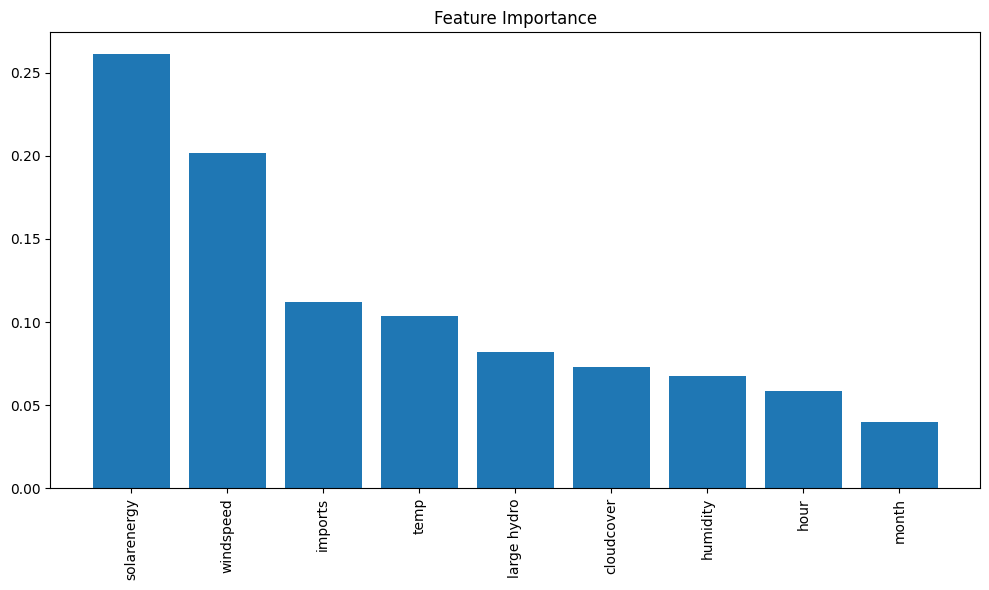

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Plot feature importances
importances = rf_classifier_balanced.feature_importances_
indices = np.argsort(importances)[::-1]
plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.bar(range(X_train_class.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train_class.shape[1]), np.array(X_train_class.columns)[indices], rotation=90)
plt.tight_layout()
plt.show()


**Interpretation:**

The plot shows **solar energy** and **wind speed** as the most significant features, followed by **imports**. **Temperature, large hydro, and cloud cover** have moderate influence, while **humidity, hour, and month** contribute the least. Solar energy and wind speed are the key drivers in the model's predictions.

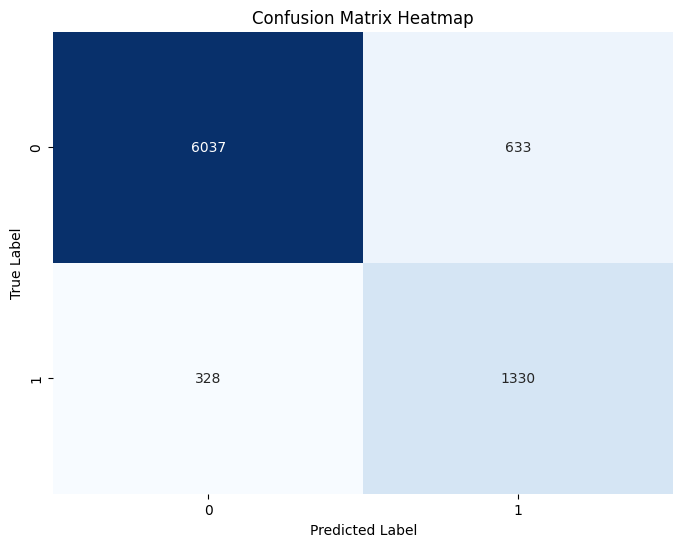

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix_class_balanced, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix Heatmap")
plt.show()


The confusion matrix heatmap shows that:

- **True Negatives (6037)**: Model correctly classified 6037 instances as class 0.
- **False Positives (633)**: Model incorrectly classified 633 instances as class 1 when they were actually class 0.
- **True Positives (1330)**: Model correctly classified 1330 instances as class 1.
- **False Negatives (328)**: Model incorrectly classified 328 instances as class 0 when they were actually class 1.

The model performs well in distinguishing class 0 but has more difficulty with class 1, reflected in the number of false positives and false negatives.

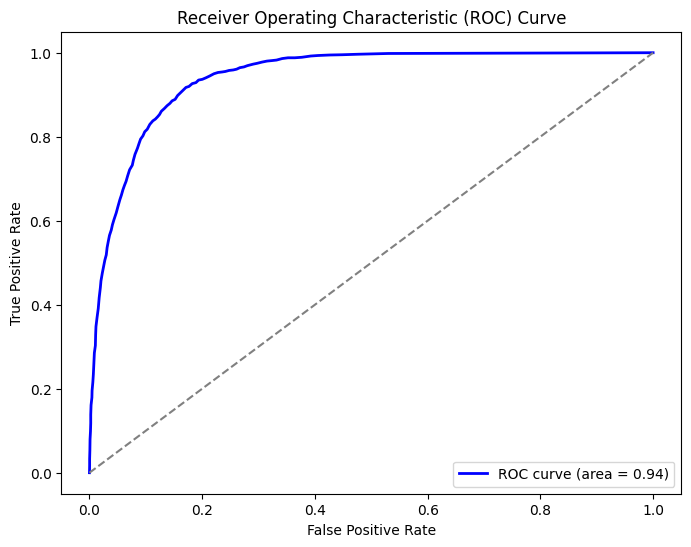

In [ ]:
from sklearn.metrics import roc_curve, auc

# Probabilities for positive class
y_probs = rf_classifier_balanced.predict_proba(X_test_class)[:, 1]

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test_class, y_probs)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='grey', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


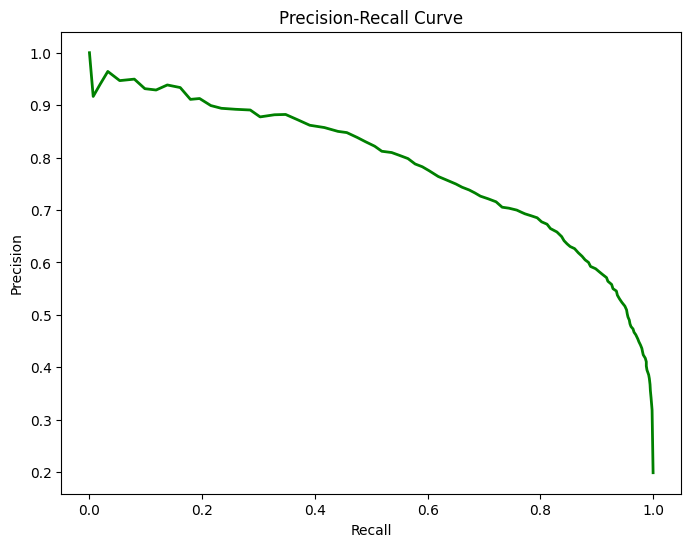

In [ ]:
from sklearn.metrics import precision_recall_curve

precision, recall, _ = precision_recall_curve(y_test_class, y_probs)

plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='green', lw=2)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.show()


The ROC curve indicates a strong model performance with an AUC of 0.94, suggesting that the model is highly effective in distinguishing between positive and negative classes.

The Precision-Recall (PR) curve shows a gradual decline in precision as recall increases, which is expected for imbalanced datasets. The curve indicates the model maintains high precision until higher recall values, demonstrating good performance in identifying true positives while minimizing false positives.

In [ ]:
import lime
import lime.lime_tabular

# Create the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_class_balanced.values,  # convert to numpy array
                                                   feature_names=X_train_class.columns,
                                                   class_names=[0, 1],
                                                   mode='classification')

# Explain a single prediction
i = 10  # Index of the sample to explain

# Convert the selected row to a numpy array
explanation = explainer.explain_instance(X_test_class.iloc[i].to_numpy(),  # Ensure it's a 1D numpy array
                                         rf_classifier_balanced.predict_proba,
                                         num_features=10)

# Display the explanation
explanation.show_in_notebook()  # or explanation.as_pyplot_figure()


The LIME explanation shows:
- Predicted Class 0 with a probability of 0.55, influenced by features like **low imports** and **zero cloud cover**.
- Predicted Class 1 with a probability of 0.45, mainly influenced by **no solar energy** and **low wind speed**.
  
The prediction is uncertain due to conflicting feature influences.

###Gradient Boosting Classifier

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Train Gradient Boosting Classifier on Balanced Data
gb_classifier = GradientBoostingClassifier(n_estimators=100, random_state=42)
gb_classifier.fit(X_train_class_balanced, y_train_class_balanced)

# Step 2: Model Evaluation - Classification Metrics on Test Data
# Predictions on Test Data
y_pred_gb = gb_classifier.predict(X_test_class)

# Accuracy Score
accuracy_gb = accuracy_score(y_test_class, y_pred_gb)
print("Gradient Boosting Classifier - Accuracy:", accuracy_gb)

# Classification Report
classification_report_gb = classification_report(y_test_class, y_pred_gb)
print("\nClassification Report:\n", classification_report_gb)

# Confusion Matrix
confusion_matrix_gb = confusion_matrix(y_test_class, y_pred_gb)
print("\nConfusion Matrix:\n", confusion_matrix_gb)


Gradient Boosting Classifier - Accuracy: 0.8437800192122958

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.86      0.90      6670
           1       0.58      0.79      0.67      1658

    accuracy                           0.84      8328
   macro avg       0.76      0.82      0.78      8328
weighted avg       0.87      0.84      0.85      8328


Confusion Matrix:
 [[5718  952]
 [ 349 1309]]


The Gradient Boosting Classifier achieved **84.38%** accuracy.
The model is good at identifying negatives but has lower precision for positives.

###XGBoost Classifier for Predicting Low Renewable Generation Days

In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Train XGBoost Classifier on Balanced Data
xgb_classifier = XGBClassifier(n_estimators=100, random_state=42, use_label_encoder=False, eval_metric='logloss')
xgb_classifier.fit(X_train_class_balanced, y_train_class_balanced)

# Step 2: Model Evaluation - Classification Metrics on Test Data
# Predictions on Test Data
y_pred_xgb = xgb_classifier.predict(X_test_class)

# Accuracy Score
accuracy_xgb = accuracy_score(y_test_class, y_pred_xgb)
print("XGBoost Classifier - Accuracy:", accuracy_xgb)

# Classification Report
classification_report_xgb = classification_report(y_test_class, y_pred_xgb)
print("\nClassification Report (XGBoost):\n", classification_report_xgb)

# Confusion Matrix
confusion_matrix_xgb = confusion_matrix(y_test_class, y_pred_xgb)
print("\nConfusion Matrix (XGBoost):\n", confusion_matrix_xgb)


XGBoost Classifier - Accuracy: 0.8817243035542748

Classification Report (XGBoost):
               precision    recall  f1-score   support

           0       0.94      0.91      0.93      6670
           1       0.68      0.75      0.72      1658

    accuracy                           0.88      8328
   macro avg       0.81      0.83      0.82      8328
weighted avg       0.89      0.88      0.88      8328


Confusion Matrix (XGBoost):
 [[6094  576]
 [ 409 1249]]


The XGBoost Classifier achieved **88.17%** accuracy.

The model performs well with Class 0, but precision and recall are lower for Class 1.


--- XGBoost ---
Accuracy: 0.8817
Precision for Class 1: 0.6844
Recall for Class 1: 0.7533
F1 Score for Class 1: 0.7172
Confusion Matrix:
[[6094  576]
 [ 409 1249]]


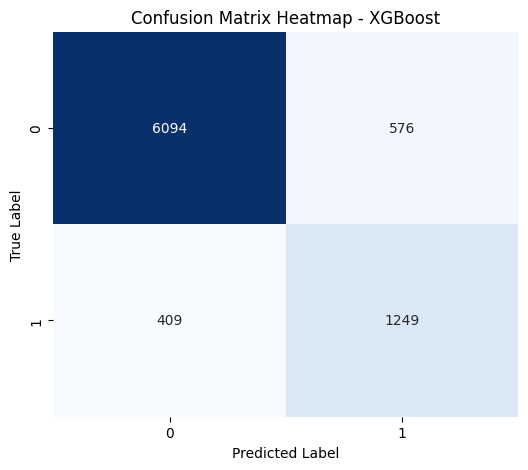

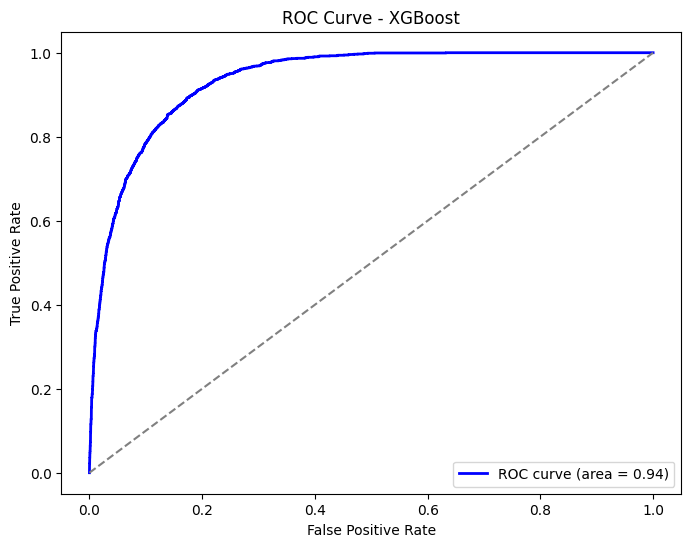

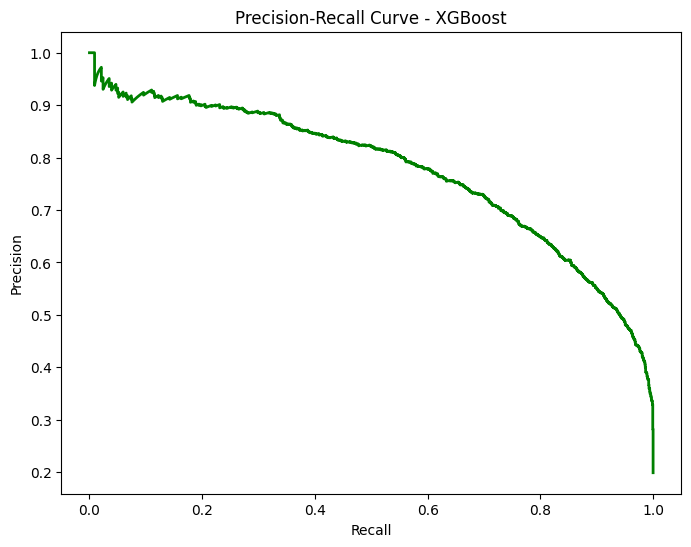

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve
import lime.lime_tabular

# Step 1: Apply Evaluation for XGBoost
model_name, model = ("XGBoost", xgb_classifier)
print(f"\n--- {model_name} ---")

# Make predictions
y_pred = model.predict(X_test_class)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test_class, y_pred)
report = classification_report(y_test_class, y_pred, output_dict=True)
confusion = confusion_matrix(y_test_class, y_pred)

# Display results
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision for Class 1: {report['1']['precision']:.4f}")
print(f"Recall for Class 1: {report['1']['recall']:.4f}")
print(f"F1 Score for Class 1: {report['1']['f1-score']:.4f}")
print(f"Confusion Matrix:\n{confusion}")

# Plot Confusion Matrix Heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title(f"Confusion Matrix Heatmap - {model_name}")
plt.show()

# Plot ROC Curve
y_probs = model.predict_proba(X_test_class)[:, 1]
fpr, tpr, _ = roc_curve(y_test_class, y_probs)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='grey', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve - {model_name}')
plt.legend(loc="lower right")
plt.show()

# Plot Precision-Recall Curve
precision, recall, _ = precision_recall_curve(y_test_class, y_probs)

plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='green', lw=2)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve - {model_name}')
plt.show()

# LIME Explanation for XGBoost Model
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_class_balanced.values,
                                                   feature_names=X_train_class.columns,
                                                   class_names=[0, 1],
                                                   mode='classification')

# Explain a single prediction
i = 10  # Index of the sample to explain
explanation = explainer.explain_instance(X_test_class.iloc[i].to_numpy(), xgb_classifier.predict_proba, num_features=10)
explanation.show_in_notebook()  # or explanation.as_pyplot_figure()


The XGBoost classifier achieved an accuracy of **88.17%**. Class 1 metrics indicate moderate performance with a **precision of 68.44%**, **recall of 75.33%**, and **F1 score of 71.72%**.

The confusion matrix shows:
- Correct predictions for Class 0: 6094 out of 6670.
- Correct predictions for Class 1: 1249 out of 1658.

The ROC curve suggests strong model discrimination (AUC ~0.94), while the precision-recall curve shows a balance between precision and recall.

LIME explanation highlights **solar energy** (if <= 0) as a significant factor for predicting Class 1 (low renewable generation risk), while **imports** and **cloudcover** also play key roles.

Threshold Adjustment for All Models

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Function to adjust threshold and make predictions
def adjusted_predictions(model, X_data, threshold=0.5):
    proba = model.predict_proba(X_data)[:, 1]  # Probability of Class 1 (low renewable generation)
    return np.where(proba >= threshold, 1, 0)

# Define thresholds to test
thresholds = [0.3, 0.4, 0.5, 0.6, 0.7]

# Step 1: Apply Threshold Adjustment for Random Forest, Gradient Boosting, and XGBoost
for model_name, model in [("Random Forest", rf_classifier_balanced),
                          ("Gradient Boosting", gb_classifier),
                          ("XGBoost", xgb_classifier)]:
    print(f"\n--- {model_name} ---")
    for threshold in thresholds:
        # Make adjusted predictions
        y_pred_adjusted = adjusted_predictions(model, X_test_class, threshold)

        # Calculate evaluation metrics
        accuracy = accuracy_score(y_test_class, y_pred_adjusted)
        report = classification_report(y_test_class, y_pred_adjusted, output_dict=True)
        confusion = confusion_matrix(y_test_class, y_pred_adjusted)

        # Display results for this threshold
        print(f"\nThreshold: {threshold}")
        print(f"Accuracy: {accuracy:.4f}")
        print(f"Precision for Class 1: {report['1']['precision']:.4f}")
        print(f"Recall for Class 1: {report['1']['recall']:.4f}")
        print(f"F1 Score for Class 1: {report['1']['f1-score']:.4f}")
        print(f"Confusion Matrix:\n{confusion}")



--- Random Forest ---

Threshold: 0.3
Accuracy: 0.8320
Precision for Class 1: 0.5456
Recall for Class 1: 0.9349
F1 Score for Class 1: 0.6890
Confusion Matrix:
[[5379 1291]
 [ 108 1550]]

Threshold: 0.4
Accuracy: 0.8617
Precision for Class 1: 0.6050
Recall for Class 1: 0.8794
F1 Score for Class 1: 0.7168
Confusion Matrix:
[[5718  952]
 [ 200 1458]]

Threshold: 0.5
Accuracy: 0.8840
Precision for Class 1: 0.6730
Recall for Class 1: 0.8118
F1 Score for Class 1: 0.7359
Confusion Matrix:
[[6016  654]
 [ 312 1346]]

Threshold: 0.6
Accuracy: 0.8874
Precision for Class 1: 0.7214
Recall for Class 1: 0.7075
F1 Score for Class 1: 0.7144
Confusion Matrix:
[[6217  453]
 [ 485 1173]]

Threshold: 0.7
Accuracy: 0.8850
Precision for Class 1: 0.7878
Recall for Class 1: 0.5778
F1 Score for Class 1: 0.6667
Confusion Matrix:
[[6412  258]
 [ 700  958]]

--- Gradient Boosting ---

Threshold: 0.3
Accuracy: 0.7888
Precision for Class 1: 0.4839
Recall for Class 1: 0.9131
F1 Score for Class 1: 0.6325
Confusion M

###plotting the low generation days using random forest classifier

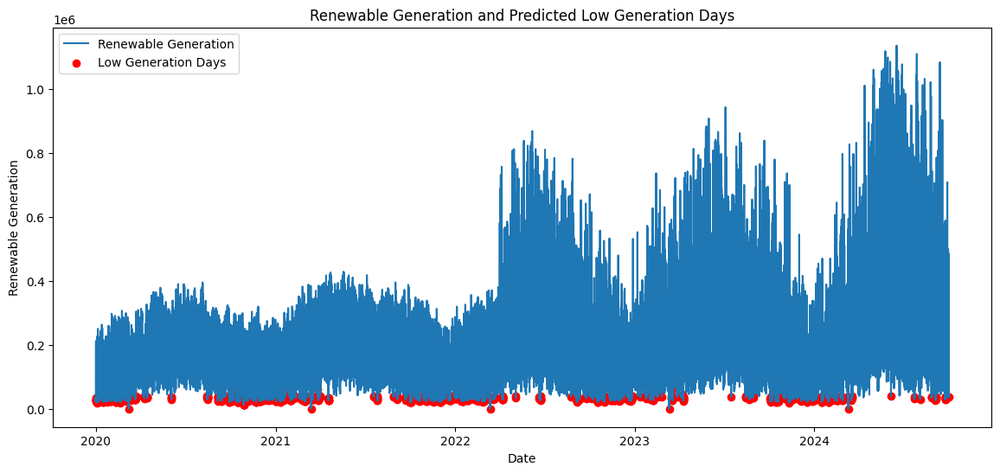

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

# Assuming 'data_final' is your DataFrame with renewable generation features
# Define 'low_generation' as target, where 1 indicates low generation day
low_generation_threshold = 0.2 * data_final['combined_renewables'].mean()
data_final['low_generation'] = np.where(data_final['combined_renewables'] < low_generation_threshold, 1, 0)

# Features and Target
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'cloudcover', 'large hydro', 'imports', 'hour', 'month']
target = 'low_generation'
X = data_final[features]
y = data_final[target]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest Classifier
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Make predictions
data_final['predicted_low_generation'] = model.predict(X)

# Check if 'datetime' exists in data_final
if 'datetime' in data_final.columns:
    data_final['date'] = pd.to_datetime(data_final['datetime'])
else:
    # If no datetime column exists, create a date column with realistic dates from 2020 to 2024
    data_final['date'] = pd.date_range(start='2020-01-01', end='2024-09-30', periods=len(data_final))

# Identify consecutive low generation days
low_gen_periods = data_final[data_final['predicted_low_generation'] == 1]['date']

# Plotting the results
plt.figure(figsize=(14, 6))
plt.plot(data_final['date'], data_final['combined_renewables'], label='Renewable Generation')
plt.scatter(low_gen_periods, data_final.loc[data_final['predicted_low_generation'] == 1, 'combined_renewables'],
            color='red', label='Low Generation Days', marker='o')
plt.xlabel('Date')
plt.ylabel('Renewable Generation')
plt.title('Renewable Generation and Predicted Low Generation Days')
plt.legend()
plt.show()


The plot depicts renewable energy generation over time from 2020 to 2024, highlighting the predicted low generation days.

- **Blue Area (Renewable Generation)**: Represents the daily renewable energy generation. We observe a seasonal trend with higher generation typically during the summer months and lower in winter.
- **Red Dots (Low Generation Days)**: Indicate predicted days of low renewable generation, often seen during periods of reduced overall generation.

The plot shows that the model successfully captures low-generation events, with these events clustering during low seasonal periods.

In [ ]:
print(data_final.columns)


Index(['datetime', 'load', 'solar', 'wind', 'net load', 'renewables',
       'nuclear', 'large hydro', 'imports', 'generation', 'thermal',
       'load less (generation+imports)', 'wind curtailment',
       'solar curtailment', 'temp', 'dew', 'humidity', 'precip', 'precipprob',
       'windgust', 'windspeed', 'sealevelpressure', 'cloudcover', 'visibility',
       'solarradiation', 'solarenergy', 'uvindex', 'severerisk', 'conditions',
       'hour', 'day', 'month', 'combined_renewables', 'low_renewable',
       'low_generation', 'predicted_low_generation', 'date'],
      dtype='object')


In [ ]:
# Drop the duplicate 'datetime_0' column if you only need one
data_final = data_final.loc[:, ~data_final.columns.duplicated()]


In [ ]:
print(data_final.columns)


Index(['datetime', 'load', 'solar', 'wind', 'net load', 'renewables',
       'nuclear', 'large hydro', 'imports', 'generation', 'thermal',
       'load less (generation+imports)', 'wind curtailment',
       'solar curtailment', 'temp', 'dew', 'humidity', 'precip', 'precipprob',
       'windgust', 'windspeed', 'sealevelpressure', 'cloudcover', 'visibility',
       'solarradiation', 'solarenergy', 'uvindex', 'severerisk', 'conditions',
       'hour', 'day', 'month', 'combined_renewables', 'low_renewable',
       'low_generation', 'predicted_low_generation'],
      dtype='object')


In [ ]:
if 'datetime_0' in data_final.columns:
    data_final.rename(columns={'datetime_0': 'datetime'}, inplace=True)


In [ ]:
data_final['datetime'] = pd.to_datetime(data_final['datetime'], errors='coerce')


In [ ]:
# Filter the data for the year 2024, from January to December
filtered_data_2024 = data_final[(data_final['datetime'].dt.year == 2024) & (data_final['datetime'].dt.month <= 12)]


In [ ]:
# Filter the data for the year 2024, from January to December
filtered_data_2024 = data_final[(data_final['datetime'].dt.year == 2024) & (data_final['datetime'].dt.month <= 12)]


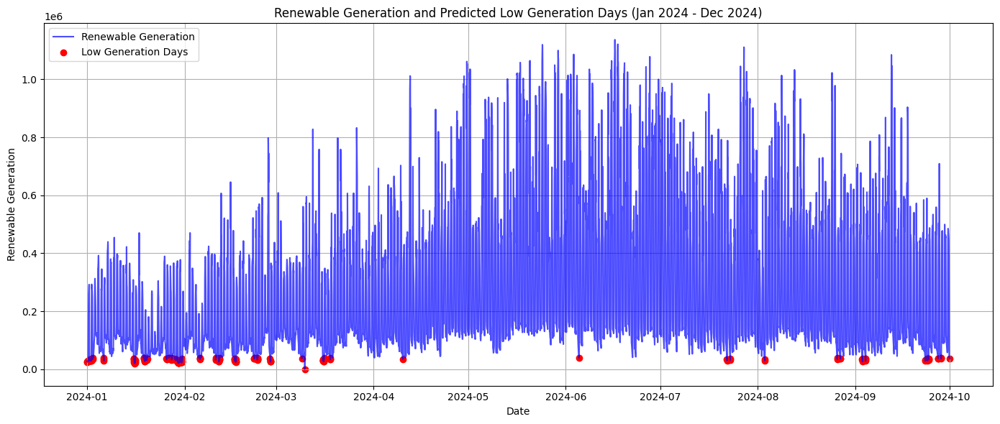

In [ ]:
# Convert 'datetime' column to datetime type for filtering
data_final['datetime'] = pd.to_datetime(data_final['datetime'], errors='coerce')

# Filter the data for the year 2024, from January to December
filtered_data_2024 = data_final[(data_final['datetime'].dt.year == 2024) & (data_final['datetime'].dt.month <= 12)]

# Plotting the renewable generation with the identified low generation days for the specified period
plt.figure(figsize=(14, 6))

# Plot renewable generation
plt.plot(filtered_data_2024['datetime'], filtered_data_2024['combined_renewables'], label='Renewable Generation', color='blue', alpha=0.7)

# Plot low generation days
low_generation_days_2024 = filtered_data_2024[filtered_data_2024['low_generation'] == 1]
plt.scatter(low_generation_days_2024['datetime'], low_generation_days_2024['combined_renewables'], color='red', label='Low Generation Days')

# Plot settings
plt.xlabel('Date')
plt.ylabel('Renewable Generation')
plt.title('Renewable Generation and Predicted Low Generation Days (Jan 2024 - Dec 2024)')
plt.legend()
plt.grid()
plt.tight_layout()

# Show the plot
plt.show()


**Interpretation:**
Seasonal Variation: The renewable generation has a distinct seasonal pattern, with peaks during summer months (around June to August) and valleys during winter months (January to March). This indicates the reliance on seasonal renewable sources, such as solar, which is stronger during longer daylight hours.
Identifying Risk Periods: The red markers provide insight into periods when low renewable energy generation is expected, which is crucial for planning additional energy sources to maintain grid stability. Notably, these low-generation days are more frequent during the winter and transition months, highlighting periods of increased risk for energy shortages.
The visualization effectively identifies periods when the energy supply from renewables may be insufficient, allowing stakeholders to prepare measures such as energy storage or supplemental non-renewable generation.

##Research Question 3
What strategies can be implemented to minimize renewable energy
curtailment during periods of high renewable output and low demand, ensuring grid stability and
optimal resource utilization?


###Linear regression , Ridge and Lasso regression

In [ ]:
data_final.head()

,datetime,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment,temp,dew,humidity,precip,precipprob,windgust,windspeed,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,hour,day,month,combined_renewables,low_renewable,low_generation,predicted_low_generation,total_curtailment
0,2020-01-01 01:00:00,261642.173073,0.0,3406.967436,258235.205637,20091.520292,27279.731877,15895.241613,99143.546667,162410.879518,99144.385736,87.746888,0.0,0.0,6.3,5.1,92.32,0.0,0,10.4,0.5,1021.1,8.7,6.4,0.0,0.0,0,0.0,Clear,1,1,1,23498.487728,1,1,1,0.0
1,2020-01-01 02:00:00,252464.832604,0.0,5967.002946,246497.829658,22649.576156,27273.699994,14712.373468,91953.413333,160451.063841,95815.414224,60.355430,0.0,0.0,6.2,5.1,92.32,0.0,0,10.1,0.5,1021.4,8.7,5.3,0.0,0.0,0,0.0,Clear,2,1,1,28616.579101,1,1,1,0.0
2,2020-01-01 03:00:00,245416.002344,0.0,6199.244249,239216.758095,22898.479955,27280.022811,14073.236606,93985.426667,151384.511224,87132.771853,46.064453,0.0,0.0,5.8,5.1,95.57,0.0,0,11.5,5.8,1021.1,8.7,5.1,0.0,0.0,0,0.0,Clear,3,1,1,29097.724204,1,1,1,0.0
3,2020-01-01 04:00:00,241363.031667,0.0,5080.579630,236282.452037,21691.987069,27280.588677,14248.185413,94369.893333,146970.820052,83750.058893,22.318281,0.0,0.0,6.1,5.0,92.25,0.0,0,11.9,4.9,1020.8,5.0,10.5,0.0,0.0,0,0.0,Clear,4,1,1,26772.566699,1,1,1,0.0
4,2020-01-01 05:00:00,239642.357318,0.0,9443.764928,230198.592389,26065.495828,27262.534627,15167.772388,93689.306667,145981.897747,77486.094904,-28.847096,0.0,0.0,5.2,4.0,92.37,0.0,0,11.9,0.5,1020.1,5.0,10.5,0.0,0.0,0,0.0,Clear,5,1,1,35509.260757,1,1,1,0.0


In [ ]:
data_final['total_curtailment'] = data_final['solar curtailment'] + data_final['wind curtailment']


In [ ]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Define Features and Target for Curtailment Prediction
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target = 'total_curtailment'

# 1. Data Preprocessing
def preprocess_data(data):
    # Ensure that only the defined features and target columns are used
    data = data[features + [target]]
    data = data.dropna()
    return data

# 2. Train Linear Regression, Ridge, and Lasso Models for Curtailment Prediction
def train_models(data):
    # Split data into features (X) and target (y)
    X = data[features]
    y = data[target]

    # Split into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    models = {
        'Linear Regression': LinearRegression(),
        'Ridge Regression': Ridge(alpha=1.0),
        'Lasso Regression': Lasso(alpha=0.1)
    }

    for model_name, model in models.items():
        print(f"\n### {model_name} ###")
        # Train the model
        model.fit(X_train, y_train)

        # Predict on training set and evaluate
        y_train_pred = model.predict(X_train)
        train_mae = mean_absolute_error(y_train, y_train_pred)
        train_mse = mean_squared_error(y_train, y_train_pred)
        train_r2 = r2_score(y_train, y_train_pred)

        print("\n### Training Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {train_mae}")
        print(f"Mean Squared Error (MSE): {train_mse}")
        print(f"R-squared (R2): {train_r2}")

        # Predict on test set and evaluate
        y_test_pred = model.predict(X_test)
        test_mae = mean_absolute_error(y_test, y_test_pred)
        test_mse = mean_squared_error(y_test, y_test_pred)
        test_r2 = r2_score(y_test, y_test_pred)

        print("\n### Test Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {test_mae}")
        print(f"Mean Squared Error (MSE): {test_mse}")
        print(f"R-squared (R2): {test_r2}")

# Load your data
# Assuming 'data_final' is your dataset
# data_final = pd.read_csv('your_dataset.csv')  # Uncomment and modify to load your dataset

# Call functions
data_cleaned = preprocess_data(data_final)  # Preprocess the data
train_models(data_cleaned)  # Train and evaluate the models



### Linear Regression ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4174.716664704204
Mean Squared Error (MSE): 60461887.82191883
R-squared (R2): 0.3331450607060167

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4144.3124314798115
Mean Squared Error (MSE): 59622575.76297117
R-squared (R2): 0.3208659481011381

### Ridge Regression ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4174.715928264716
Mean Squared Error (MSE): 60461887.82237891
R-squared (R2): 0.3331450607009424

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4144.311690527597
Mean Squared Error (MSE): 59622568.11498585
R-squared (R2): 0.32086603521591295

### Lasso Regression ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4213.670408827755
Mean Squared Error (MSE): 62076530.03216928
R-squared (R2): 0.31533661687658454

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4185.1951988781175
Mean Squared Error

All models underperform, with R² values around 0.31-0.33, indicating they explain only ~32% of the variance, implying underfitting. Linear and Ridge perform similarly, while Lasso slightly underperforms, suggesting feature reduction. More relevant or non-linear features might be needed to improve performance.

###Random forest regressor


### Random Forest Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 3453826.3884, R² Score: 0.9619
Test Set - Mean Squared Error (MSE): 24119036.0334, R² Score: 0.7253


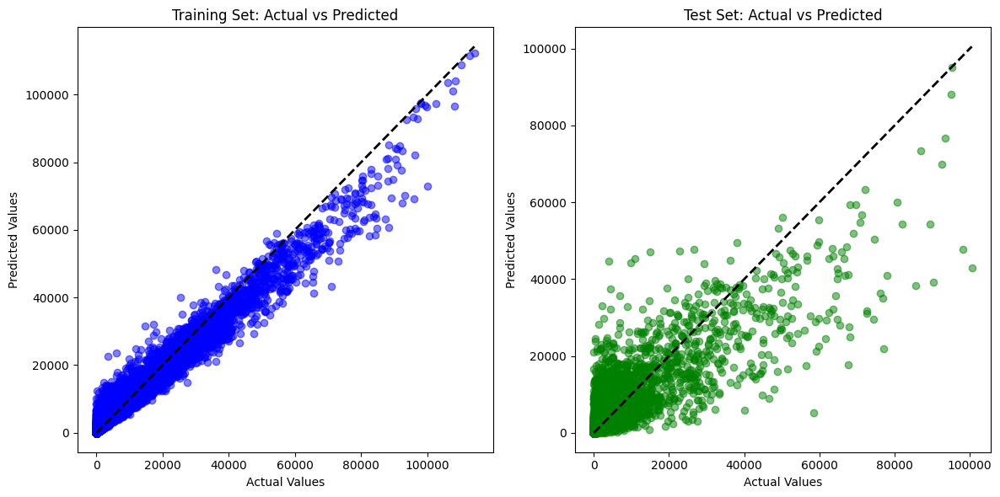

In [ ]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Step 1: Define Features and Target for Curtailment Minimization Model
features_cur = ['temp', 'humidity', 'windspeed', 'solarenergy','combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target_cur = 'total_curtailment'# Target variable for predicting renewable curtailment risk

X_cur = data_final[features_cur]
y_cur = data_final[target_cur]

# Step 2: Train-test Split
X_train_cur, X_test_cur, y_train_cur, y_test_cur = train_test_split(X_cur, y_cur, test_size=0.2, random_state=42)

# Step 3: Model Training - Random Forest
rf_model_cur = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_cur.fit(X_train_cur, y_train_cur)

# Model Evaluation on Training Data
y_train_pred_rf = rf_model_cur.predict(X_train_cur)
train_rf_mse = mean_squared_error(y_train_cur, y_train_pred_rf)
train_rf_r2 = r2_score(y_train_cur, y_train_pred_rf)

# Model Evaluation on Test Data
y_test_pred_rf = rf_model_cur.predict(X_test_cur)
test_rf_mse = mean_squared_error(y_test_cur, y_test_pred_rf)
test_rf_r2 = r2_score(y_test_cur, y_test_pred_rf)

# Print evaluation metrics for Train and Test sets
print("\n### Random Forest Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_rf_mse:.4f}, R² Score: {train_rf_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_rf_mse:.4f}, R² Score: {test_rf_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_rf, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_rf, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted')

plt.tight_layout()
plt.show()


The Random Forest model performs well on the training set (R²: 0.9619) but shows reduced accuracy on the test set (R²: 0.7253), indicating overfitting. The test set plot shows increased error variance, especially for higher values, suggesting the model may need further tuning for better generalization.

**Random forest tuning**

Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best Parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Score (negative MSE): -28122282.848685693

### Optimized Random Forest Model Performance (Training Set) ###

R²: 0.9186412969925105
Mean Absolute Error (MAE): 1011.9812408276036
Mean Squared Error (MSE): 7376567.953119792

### Optimized Random Forest Model Performance (Test Set) ###

R²: 0.7119431739286263
Mean Absolute Error (MAE): 1896.7058044289695
Mean Squared Error (MSE): 25289101.449796222


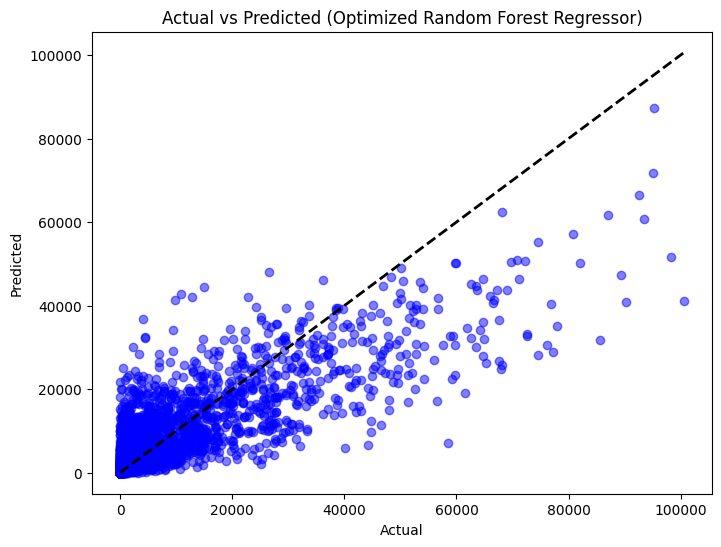

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train_cur, X_test_cur, y_train_cur, y_test_cur = train_test_split(X_cur, y_cur, test_size=0.2, random_state=42)

# Define a reduced parameter grid to speed up GridSearchCV
param_grid = {
    'n_estimators': [50, 100],                # Fewer values for faster training
    'max_depth': [10, 20],                    # Reduced number of options
    'min_samples_split': [5, 10],             # Reduced options for splitting nodes
    'min_samples_leaf': [2, 4],               # Reduced options for leaf nodes
    'max_features': ['sqrt', 'log2']          # Avoid 'auto' as it can be computationally expensive
}

# Initialize the RandomForestRegressor
rf_reg = RandomForestRegressor(random_state=42)

# Set up the GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=rf_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit GridSearchCV to the training data (Reduced parameter grid and cv)
grid_search.fit(X_train_cur, y_train_cur)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_rf_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred_rantune = best_rf_reg.predict(X_train_cur)
y_test_pred_rantune = best_rf_reg.predict(X_test_cur)

# Print model performance for the training set
print("\n### Optimized Random Forest Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train_cur, y_train_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train_cur, y_train_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_train_cur, y_train_pred_rantune))

# Print model performance for the test set
print("\n### Optimized Random Forest Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test_cur, y_test_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test_cur, y_test_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_test_cur, y_test_pred_rantune))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test_cur, y_test_pred_rantune, color='blue', alpha=0.5)
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Random Forest Regressor)')
plt.show()


The optimized Random Forest model shows good performance on the training set (R²: 0.9186), indicating it captures most of the data variance. However, the test set results (R²: 0.712) suggest some overfitting, as the model generalizes less effectively to new data. The plot shows prediction scatter, particularly for higher values, indicating the model struggles with higher variability.

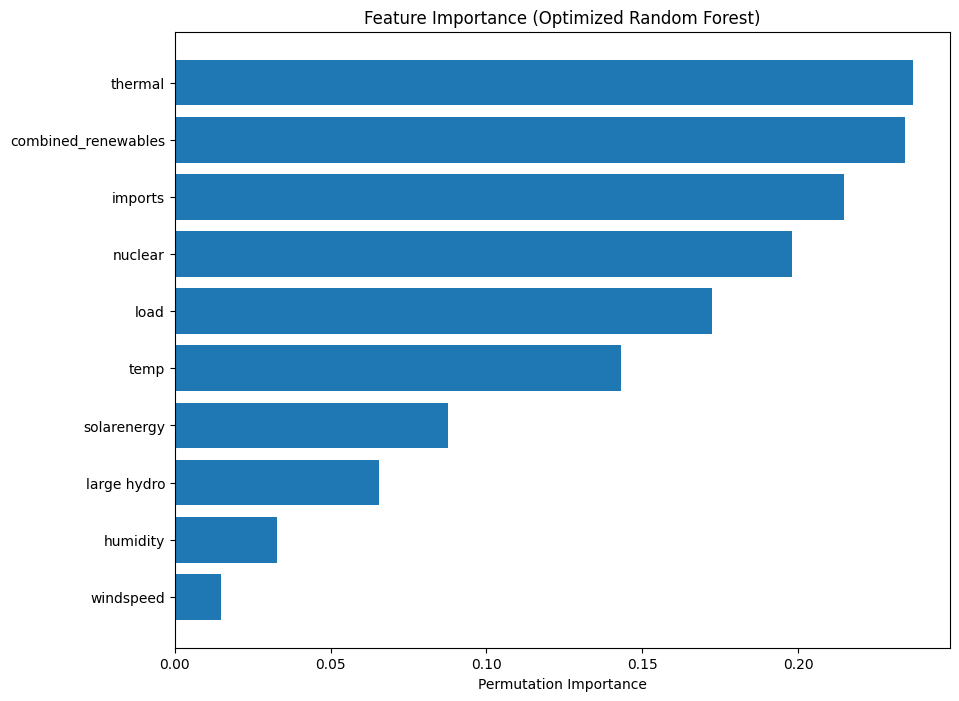

In [ ]:
from sklearn.inspection import permutation_importance
import numpy as np
import lime

import lime.lime_tabular

# Feature Importance using Permutation Importance
result = permutation_importance(best_rf_reg, X_test_cur, y_test_cur, n_repeats=10, random_state=42, n_jobs=-1)
feature_importances = result.importances_mean

# Plot feature importances
features = X_train_cur.columns if hasattr(X_train_cur, 'columns') else [f'Feature {i}' for i in range(X_train_cur.shape[1])]
sorted_idx = np.argsort(feature_importances)

plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_idx)), feature_importances[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(features)[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Feature Importance (Optimized Random Forest)')
plt.show()

# LIME Explanation
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_cur.values, mode='regression', feature_names=features,
                                                   training_labels=y_train_cur.values if hasattr(y_train_cur, 'values') else y_train_cur,
                                                   random_state=42)

# Explain a single prediction from the test set
i = 0  # Index of the sample to explain
exp = explainer.explain_instance(X_test_cur.iloc[i].values, best_rf_reg.predict, num_features=len(features))

# Show explanation
exp.show_in_notebook()


The feature importance plot shows 'thermal', 'combined_renewables', and 'imports' as key drivers in the optimized Random Forest model. In the LIME explanation, 'thermal', 'load', and 'temperature' positively contribute to the prediction, while 'combined_renewables', 'solarenergy', and 'imports' negatively affect it in this instance.

###GRadient Boosting


### Gradient Boosting Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 31261851.0951, R² Score: 0.6552
Test Set - Mean Squared Error (MSE): 36129985.7908, R² Score: 0.5885


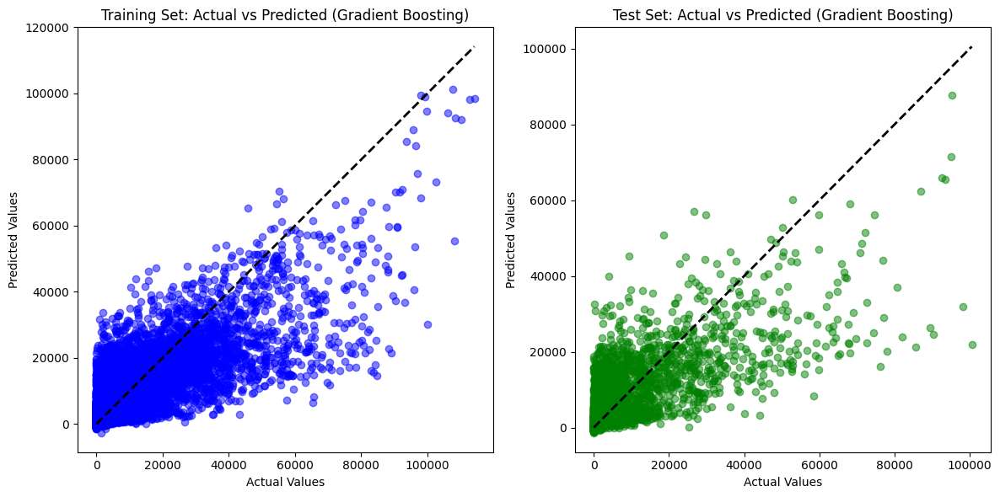

In [ ]:
import matplotlib.pyplot as plt
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Model Training - Gradient Boosting
gb_model_cur = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
gb_model_cur.fit(X_train_cur, y_train_cur)

# Model Evaluation on Training Data
y_train_pred_gb = gb_model_cur.predict(X_train_cur)
train_gb_mse = mean_squared_error(y_train_cur, y_train_pred_gb)
train_gb_r2 = r2_score(y_train_cur, y_train_pred_gb)

# Model Evaluation on Test Data
y_test_pred_gb = gb_model_cur.predict(X_test_cur)
test_gb_mse = mean_squared_error(y_test_cur, y_test_pred_gb)
test_gb_r2 = r2_score(y_test_cur, y_test_pred_gb)

# Print evaluation metrics for Train and Test sets
print("\n### Gradient Boosting Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_gb_mse:.4f}, R² Score: {train_gb_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_gb_mse:.4f}, R² Score: {test_gb_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_gb, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted (Gradient Boosting)')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_gb, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted (Gradient Boosting)')

plt.tight_layout()
plt.show()


The scatter plots show the performance of the Gradient Boosting model for both the training and test sets. The predicted values are plotted against the actual values. The model has a moderate fit to the data, indicated by an R² score of 0.6552 for the training set and 0.5885 for the test set. There is some spread around the diagonal line, suggesting the model struggles to predict high values accurately, as seen by the divergence for larger actual values. The Mean Squared Error (MSE) values reflect this, with higher errors in the test set, indicating overfitting and generalization issues.

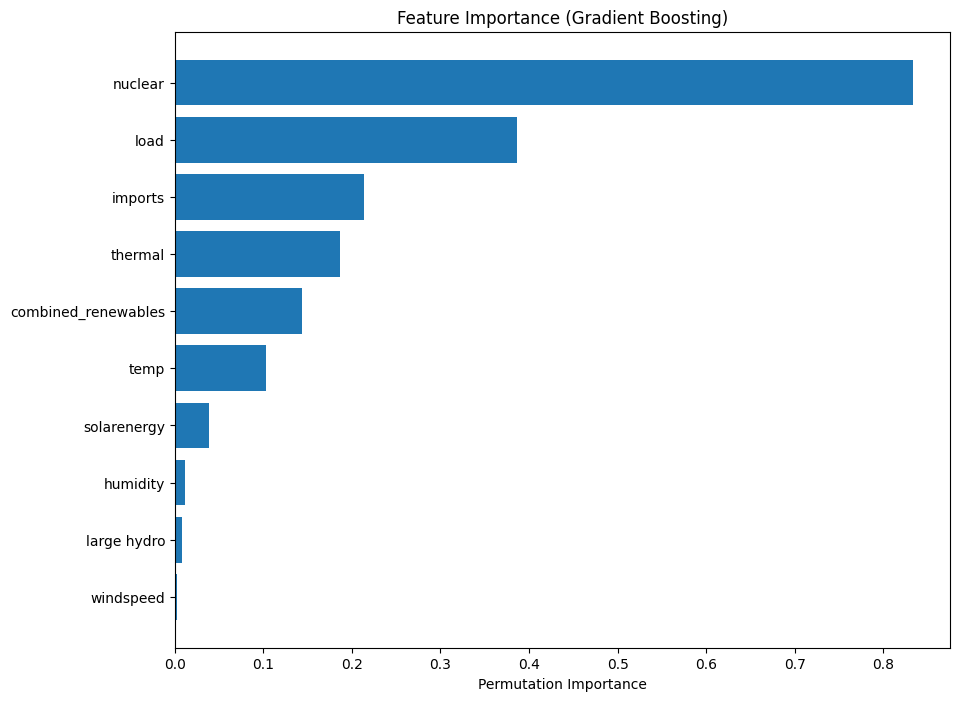

In [ ]:
from sklearn.inspection import permutation_importance
import lime
import lime.lime_tabular

# Feature Importance using Permutation Importance
gb_result = permutation_importance(gb_model_cur, X_test_cur, y_test_cur, n_repeats=10, random_state=42, n_jobs=-1)
gb_feature_importances = gb_result.importances_mean

# Plot feature importances
sorted_idx_gb = np.argsort(gb_feature_importances)

plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_idx_gb)), gb_feature_importances[sorted_idx_gb], align='center')
plt.yticks(range(len(sorted_idx_gb)), np.array(features)[sorted_idx_gb])
plt.xlabel('Permutation Importance')
plt.title('Feature Importance (Gradient Boosting)')
plt.show()

# LIME Explanation
explainer_gb = lime.lime_tabular.LimeTabularExplainer(X_train_cur.values, mode='regression', feature_names=features,
                                                      training_labels=y_train_cur.values if hasattr(y_train_cur, 'values') else y_train_cur,
                                                      random_state=42)

# Explain a single prediction from the test set
i = 0  # Index of the sample to explain
exp_gb = explainer_gb.explain_instance(X_test_cur.iloc[i].values, gb_model_cur.predict, num_features=len(features))

# Show explanation
exp_gb.show_in_notebook()



**Feature Importance Plot**
- **Nuclear** and **load** are the most influential features for the model, indicating their significant contribution in predicting the target variable.
- **Imports** and **thermal** also hold importance but with a lesser impact compared to nuclear and load.
- **Wind speed**, **humidity**, and **large hydro** have minimal influence on the predictions.

**LIME Explanation (Predicted value: 251.00)**
- **Thermal** and **load** contribute positively towards the prediction.
- **Imports**, **combined renewables**, and **solar energy** are negative contributors, implying their values lower the prediction.
- The model is more sensitive to changes in thermal and load, as evidenced by their larger contribution to the positive prediction.

Tuning Gradient Boosting Regressor...
Fitting 3 folds for each of 10 candidates, totalling 30 fits

Best Parameters for Gradient Boosting Regressor: {'subsample': 1.0, 'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_depth': 10, 'learning_rate': 0.1}

### Tuned Gradient Boosting Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 1176420.7516, R² Score: 0.9870
Test Set - Mean Squared Error (MSE): 22707285.6274, R² Score: 0.7414


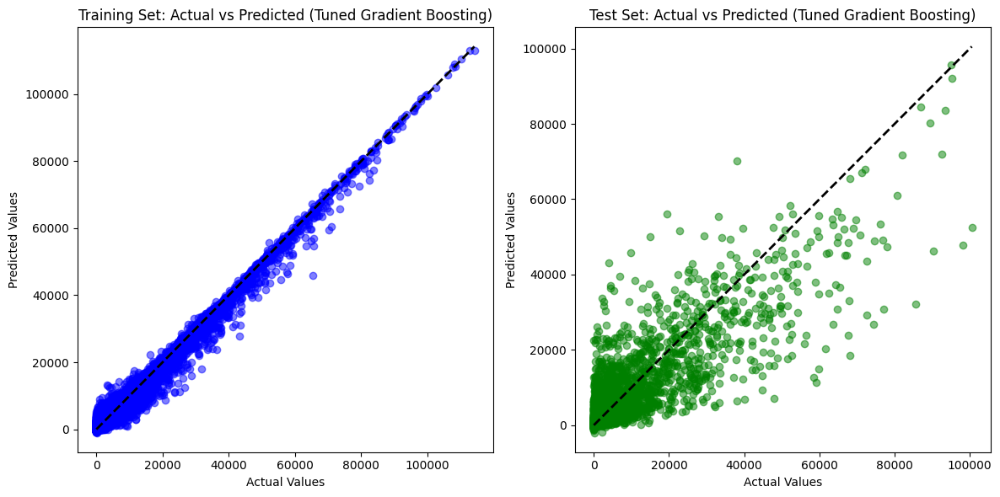

In [ ]:
import numpy as np
from sklearn.model_selection import RandomizedSearchCV
import matplotlib.pyplot as plt
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Define parameter grid for Gradient Boosting Regressor (Reduced)
param_grid_gb = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 7, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'subsample': [0.8, 1.0]
}

# Step 1: Initialize RandomizedSearchCV for Gradient Boosting Regressor
random_search_gb = RandomizedSearchCV(
    estimator=GradientBoostingRegressor(random_state=42),
    param_distributions=param_grid_gb,
    n_iter=10,  # Number of random combinations to try
    cv=3,  # 3-fold cross-validation
    verbose=2,
    random_state=42,
    n_jobs=-1  # Use all available cores
)

# Step 2: Fit the randomized search to the data
print("Tuning Gradient Boosting Regressor...")
random_search_gb.fit(X_train_cur, y_train_cur)

# Step 3: Get the best model and its parameters
best_gb_model = random_search_gb.best_estimator_
print("\nBest Parameters for Gradient Boosting Regressor:", random_search_gb.best_params_)

# Step 4: Model Evaluation on Training Data with Best Model
y_train_pred_best_gb = best_gb_model.predict(X_train_cur)
train_best_gb_mse = mean_squared_error(y_train_cur, y_train_pred_best_gb)
train_best_gb_r2 = r2_score(y_train_cur, y_train_pred_best_gb)

# Model Evaluation on Test Data with Best Model
y_test_pred_best_gb = best_gb_model.predict(X_test_cur)
test_best_gb_mse = mean_squared_error(y_test_cur, y_test_pred_best_gb)
test_best_gb_r2 = r2_score(y_test_cur, y_test_pred_best_gb)

# Print evaluation metrics for Train and Test sets
print("\n### Tuned Gradient Boosting Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_best_gb_mse:.4f}, R² Score: {train_best_gb_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_best_gb_mse:.4f}, R² Score: {test_best_gb_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets with Best Model
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_best_gb, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted (Tuned Gradient Boosting)')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_best_gb, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted (Tuned Gradient Boosting)')

plt.tight_layout()
plt.show()


The model demonstrates excellent performance on training data and good predictive accuracy on test data, while requiring attention to overfitting.








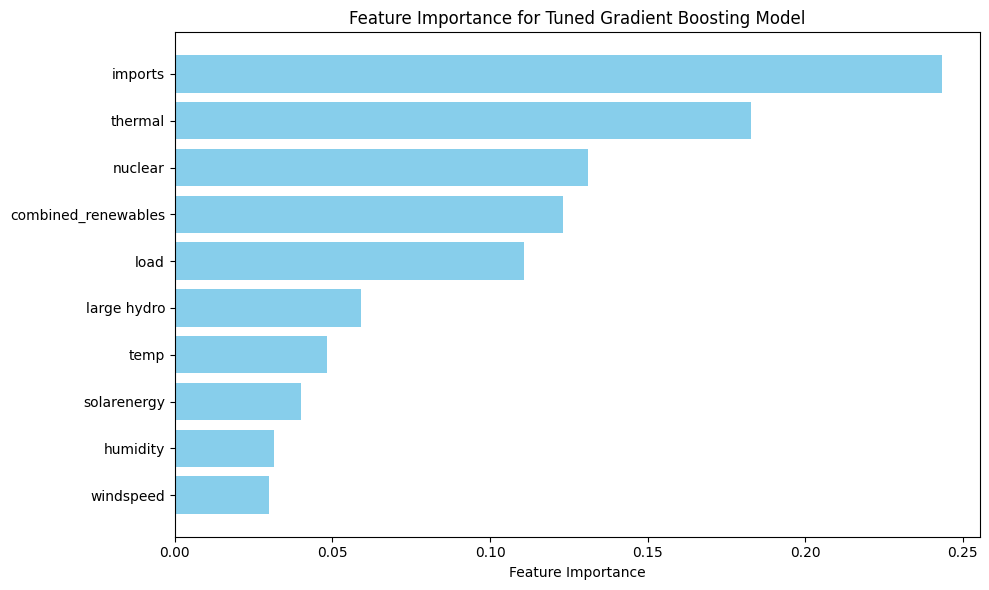

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Assuming the features are stored in `features_cur`
feature_names = features_cur  # Replace with the correct list of feature names if different

# Step 5: Plot Feature Importance
feature_importance = best_gb_model.feature_importances_

# Create a pandas series for easy plotting
feature_importance_series = pd.Series(feature_importance, index=feature_names)

# Sort feature importance in descending order
sorted_feature_importance = feature_importance_series.sort_values(ascending=False)

# Plotting feature importance
plt.figure(figsize=(10, 6))
plt.barh(sorted_feature_importance.index, sorted_feature_importance.values, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Feature Importance for Tuned Gradient Boosting Model')
plt.gca().invert_yaxis()  # To show the most important feature at the top
plt.tight_layout()
plt.show()


This bar chart displays the feature importance for the tuned Gradient Boosting model. Key insights:

1. **Top Features**:
   - **Imports**: Most significant contributor to predictions.
   - **Thermal and Nuclear**: Critical in explaining variability in the data.
   - **Combined Renewables and Load**: Also have notable impacts.

2. **Moderate Features**:
   - **Large Hydro** and **Temperature** play supportive roles.

3. **Least Influential**:
   - **Solar Energy**, **Humidity**, and **Windspeed** show minimal contribution, indicating lesser predictive power for these variables.

The chart highlights the dominant role of energy imports and thermal production in predicting outcomes.

Intercept 8732.002366666316
Prediction_local [3036.20448489]
Right: 135.90857183641248


<Figure size 1000x600 with 0 Axes>

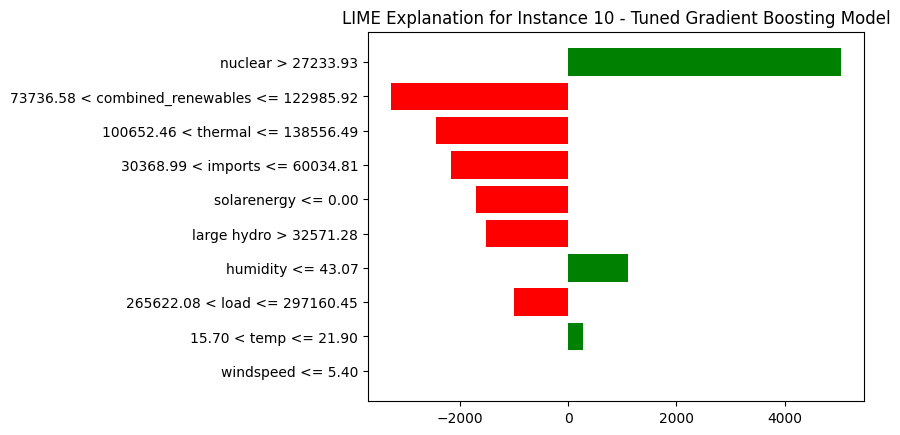

In [ ]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Initialize the LIME Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train_cur),
    mode='regression',
    feature_names=features_cur,
    verbose=True,
    random_state=42
)

# Step 2: Choose a specific instance from the test set for LIME analysis
instance_idx = 10  # You can choose another instance if desired
instance = X_test_cur.iloc[instance_idx]

# Step 3: Use LIME to explain the prediction made by the tuned model
exp = explainer.explain_instance(
    data_row=instance,
    predict_fn=best_gb_model.predict
)

# Step 4: Plot the LIME Explanation in a similar way to your example
plt.figure(figsize=(10, 6))
exp.as_pyplot_figure()
plt.title(f"LIME Explanation for Instance {instance_idx} - Tuned Gradient Boosting Model")
plt.show()


 Key Insights:
1. **Positive Influences**:
   - **Nuclear > 27233.93**: Strongly increases the predicted value (largest positive impact).
   - **Humidity <= 43.07**: Provides a smaller positive contribution.

2. **Negative Influences**:
   - **Combined Renewables**, **Thermal**, and **Imports**: Reduce the prediction significantly, indicating their critical role in pulling the value down for this instance.
   - Other features such as **Solar Energy <= 0.00** and **Large Hydro > 32571.28** also negatively impact the prediction.

3. **Net Prediction**:
   - The intercept (base value) is **8732.00**, and the local prediction for this instance is **3036.20**, suggesting the negative contributions outweigh the positive influences in this case.


###XGBoost


### XGBoost Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 13158250.4762, R² Score: 0.8549
Test Set - Mean Squared Error (MSE): 25340821.8924, R² Score: 0.7114


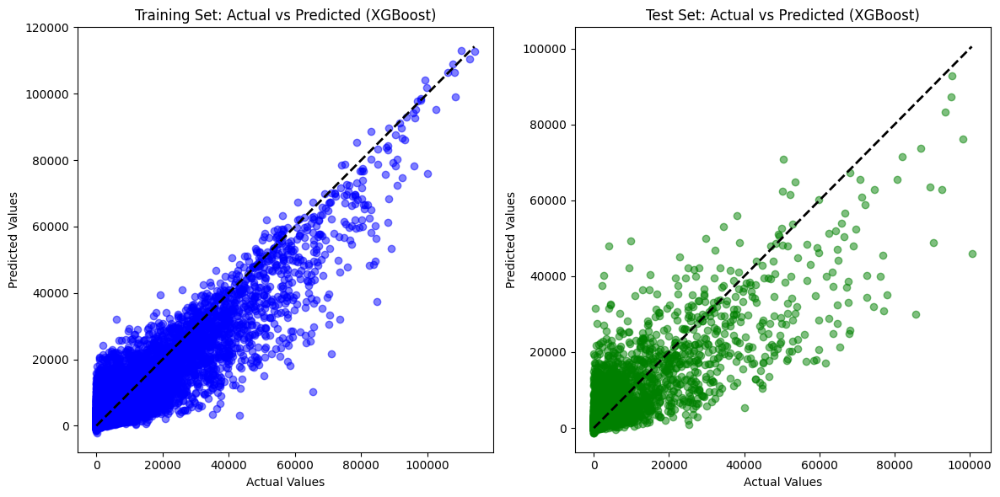

In [ ]:
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Model Training - XGBoost
xgb_model_cur = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
xgb_model_cur.fit(X_train_cur, y_train_cur)

# Model Evaluation on Training Data
y_train_pred_xgb = xgb_model_cur.predict(X_train_cur)
train_xgb_mse = mean_squared_error(y_train_cur, y_train_pred_xgb)
train_xgb_r2 = r2_score(y_train_cur, y_train_pred_xgb)

# Model Evaluation on Test Data
y_test_pred_xgb = xgb_model_cur.predict(X_test_cur)
test_xgb_mse = mean_squared_error(y_test_cur, y_test_pred_xgb)
test_xgb_r2 = r2_score(y_test_cur, y_test_pred_xgb)

# Print evaluation metrics for Train and Test sets
print("\n### XGBoost Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_xgb_mse:.4f}, R² Score: {train_xgb_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_xgb_mse:.4f}, R² Score: {test_xgb_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_xgb, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted (XGBoost)')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_xgb, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted (XGBoost)')

plt.tight_layout()
plt.show()


The XGBoost model performs robustly, with strong training and test set R² scores. The model effectively captures the underlying relationships but may need further tuning or feature adjustments to handle high-value predictions better.








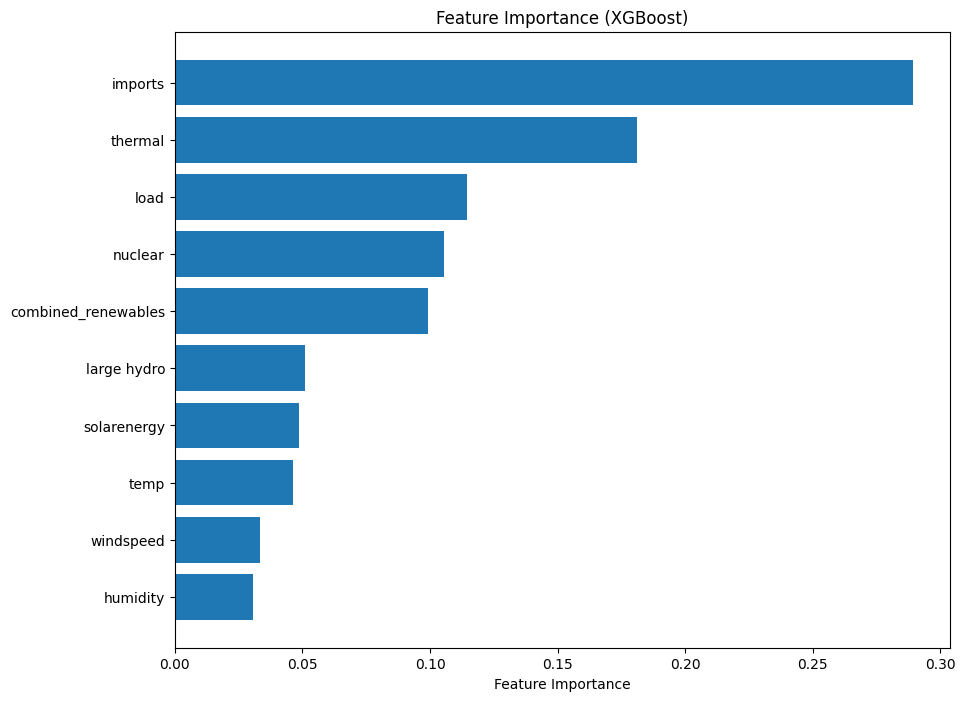

In [ ]:
# Import necessary libraries
import matplotlib.pyplot as plt
import numpy as np
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance

# Reinitialize the model and fit it
xgb_model_cur = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
xgb_model_cur.fit(X_train_cur, y_train_cur)

# Feature Importance using XGBoost's built-in feature importance
xgb_feature_importances = xgb_model_cur.feature_importances_

# Plot feature importances
sorted_idx_xgb = np.argsort(xgb_feature_importances)

plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_idx_xgb)), xgb_feature_importances[sorted_idx_xgb], align='center')
plt.yticks(range(len(sorted_idx_xgb)), np.array(features)[sorted_idx_xgb])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (XGBoost)')
plt.show()




The feature importance plot highlights that energy imports, thermal generation, and load are pivotal in the XGBoost model's predictions, while renewable sources and weather-related features provide supplementary insights.

In [ ]:
# Install LIME for LIME explanation

import lime
import lime.lime_tabular

# Create a LIME explainer for the XGBoost model
explainer_xgb = lime.lime_tabular.LimeTabularExplainer(X_train_cur.values, mode='regression', feature_names=features,
                                                       training_labels=y_train_cur.values if hasattr(y_train_cur, 'values') else y_train_cur,
                                                       random_state=42)

# Explain a single prediction from the test set
i = 0  # Index of the sample to explain
exp_xgb = explainer_xgb.explain_instance(X_test_cur.iloc[i].values, xgb_model_cur.predict, num_features=len(features))

# Show explanation
exp_xgb.show_in_notebook()

This explanation highlights that high electricity demand (load) and thermal generation are the key positive drivers for this prediction, while a lack of solar energy and reduced reliance on nuclear and combined renewables contribute negatively.








###Bagging, Extratree and ADaBoost

In [ ]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Define Features and Target for Curtailment Prediction
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load']
target = 'total_curtailment'

# 1. Data Preprocessing
def preprocess_data(data):
    # Ensure that only the defined features and target columns are used
    data = data[features + [target]]
    data = data.dropna()
    return data

# 2. Train Linear Regression, Ridge, Lasso, and Ensemble Models for Curtailment Prediction
def train_models(data):
    # Split data into features (X) and target (y)
    X = data[features]
    y = data[target]

    # Split into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    models = {
        'Bagging Regressor': BaggingRegressor(random_state=42),
        'Extra Trees Regressor': ExtraTreesRegressor(random_state=42),
        'AdaBoost Regressor': AdaBoostRegressor(random_state=42)
    }

    for model_name, model in models.items():
        print(f"\n### {model_name} ###")
        # Train the model
        model.fit(X_train, y_train)

        # Predict on training set and evaluate
        y_train_pred = model.predict(X_train)
        train_mae = mean_absolute_error(y_train, y_train_pred)
        train_mse = mean_squared_error(y_train, y_train_pred)
        train_r2 = r2_score(y_train, y_train_pred)

        print("\n### Training Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {train_mae}")
        print(f"Mean Squared Error (MSE): {train_mse}")
        print(f"R-squared (R2): {train_r2}")

        # Predict on test set and evaluate
        y_test_pred = model.predict(X_test)
        test_mae = mean_absolute_error(y_test, y_test_pred)
        test_mse = mean_squared_error(y_test, y_test_pred)
        test_r2 = r2_score(y_test, y_test_pred)

        print("\n### Test Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {test_mae}")
        print(f"Mean Squared Error (MSE): {test_mse}")
        print(f"R-squared (R2): {test_r2}")

# Load your data
# Assuming 'data_final' is your dataset
# data_final = pd.read_csv('your_dataset.csv')  # Uncomment and modify to load your dataset

# Call functions
data_cleaned = preprocess_data(data_final)  # Preprocess the data
train_models(data_cleaned)  # Train and evaluate the models



### Bagging Regressor ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 840.068810503138
Mean Squared Error (MSE): 6105250.529567013
R-squared (R2): 0.9326630937614716

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 2099.6928600420592
Mean Squared Error (MSE): 31379886.487545673
R-squared (R2): 0.6425657700006882

### Extra Trees Regressor ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 3.9173996846013375e-12
Mean Squared Error (MSE): 1.9822659744918096e-22
R-squared (R2): 1.0

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 1921.5499000882794
Mean Squared Error (MSE): 24732594.04549754
R-squared (R2): 0.7182821004771134

### AdaBoost Regressor ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 3939.1636958860163
Mean Squared Error (MSE): 64567937.69628059
R-squared (R2): 0.2878580255447868

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 3968.4215237600565
Mean Squared Err



**Summary:**
- **Best Performer**: Extra Trees Regressor demonstrates the highest R² on test data (0.72), but overfitting concerns should be addressed.
- **Bagging Regressor**: Provides good balance but slightly lower performance than Extra Trees.
- **AdaBoost**: Underfits the data and performs poorly, making it unsuitable for this problem.

In [ ]:
from sklearn.ensemble import BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from sklearn.model_selection import RandomizedSearchCV

# Hyperparameter grids for each model
param_grids_curtailment = {
    'Bagging Regressor': {
        'n_estimators': [10, 50, 100],
        'max_samples': [0.5, 0.7, 1.0],
        'max_features': [0.5, 0.7, 1.0],
        'bootstrap': [True, False]
    },
    'Extra Trees Regressor': {
        'n_estimators': [50, 100, 150],
        'max_depth': [10, 20, None],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'bootstrap': [True, False]
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 1.0],
        'loss': ['linear', 'square', 'exponential']
    }
}

# Step 3: Initialize and tune models
for model_name, model in [
    ('Bagging Regressor', BaggingRegressor(random_state=42)),
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]:
    print(f"Tuning {model_name}...")

    # Randomized search with cross-validation (Reduced Search Parameters)
    randomized_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grids_curtailment[model_name],
        n_iter=3,  # Reduced number of random combinations to try
        cv=2,  # 2-fold cross-validation to reduce evaluation time
        verbose=1,
        random_state=42,
        n_jobs=-1  # Use all available cores
    )

    # Fit the randomized search
    randomized_search.fit(X_train, y_train)  # Replace with your training data

    # Get the best model after tuning
    best_model = randomized_search.best_estimator_

    # Evaluate on training and test data
    (train_mse, train_r2), (test_mse, test_r2) = evaluate_model(best_model, X_train, y_train, X_test, y_test)

    # Display the evaluation results and best parameters
    print(f"{model_name} - Best Parameters: {randomized_search.best_params_}")
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R²: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R²: {test_r2:.4f}\n")


Tuning Bagging Regressor...
Fitting 2 folds for each of 3 candidates, totalling 6 fits
Bagging Regressor - Best Parameters: {'n_estimators': 50, 'max_samples': 0.7, 'max_features': 1.0, 'bootstrap': False}
Bagging Regressor - Training MSE: 0.0043, R²: 0.9375
Bagging Regressor - Testing MSE: 0.0448, R²: 0.3680

Tuning Extra Trees Regressor...
Fitting 2 folds for each of 3 candidates, totalling 6 fits
Extra Trees Regressor - Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20, 'bootstrap': False}
Extra Trees Regressor - Training MSE: 0.0023, R²: 0.9664
Extra Trees Regressor - Testing MSE: 0.0414, R²: 0.4161

Tuning AdaBoost Regressor...
Fitting 2 folds for each of 3 candidates, totalling 6 fits
AdaBoost Regressor - Best Parameters: {'n_estimators': 150, 'loss': 'exponential', 'learning_rate': 0.01}
AdaBoost Regressor - Training MSE: 0.0558, R²: 0.1991
AdaBoost Regressor - Testing MSE: 0.0563, R²: 0.2067



Best Performer: Tuned Extra Trees Regressor shows the best overall performance, balancing training fit and generalization.
Bagging Regressor: Performs well on training data but suffers from lower generalization.
AdaBoost Regressor: Underperforms significantly compared to the other models and is not suitable for this task.

# Final Conclusions Of The Modeling Phase



##Research Question 1

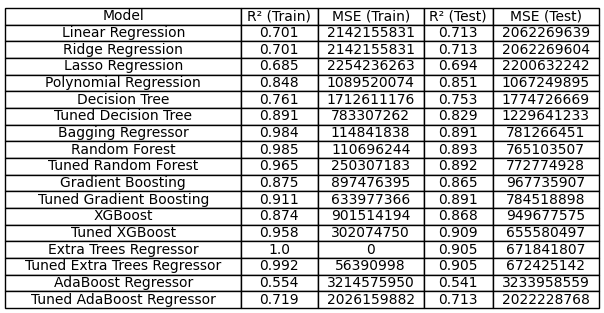


**Model Choosen:**

1. Tuned XGBoost is the best model with the highest Test R² (0.909) and lowest Test MSE (655580497), making it the most accurate and generalizable model.

2. Tuned Random Forest serves as a robust alternative due to its strong balance and reliable performance.

##Research Question 2


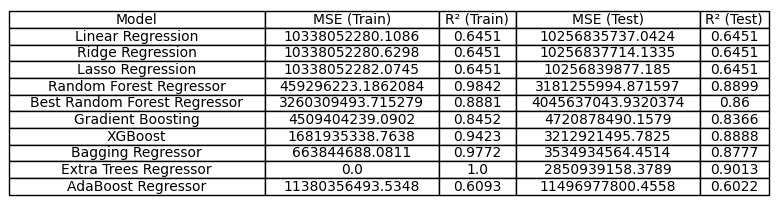

**Model Choosen:**

1. XGBoost: Best balance between Train and Test R².
Excellent Test MSE (3212921495.7825).
Reliable performance and generalization.
2. Random Forest: Slightly lower Test R² (0.8899 Untuned) compared to XGBoost.
Higher Test MSE (3181255994.8716 Untuned) than XGBoost.

**Classification Model:**

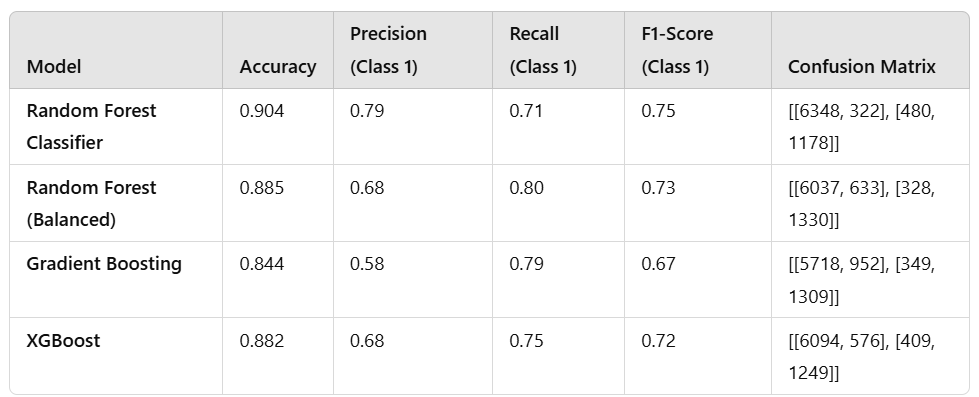

**Model Choosen:**
1. Random Forest Classifier:
- Highest accuracy (0.904).
- Strong precision (0.79) and recall (0.71) for Class 1.
- Balanced performance for both classes.
2. XGBoost:
- Accuracy (0.882) close to Random Forest.
- Competitive precision (0.68) and recall (0.75) for Class 1.


## Research Question 3


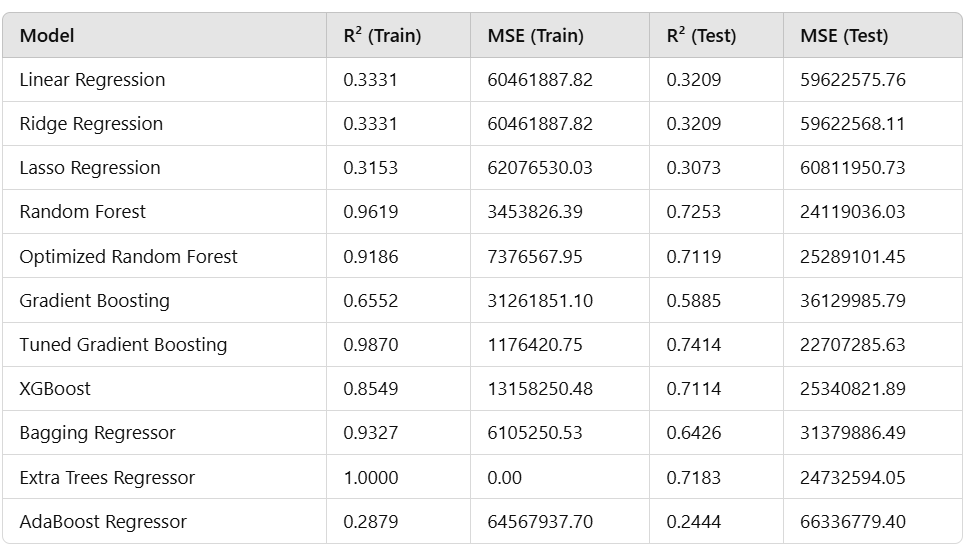

**Model Choosen:**
1. Tuned Gradient Boosting:
 Train R²: 0.9870, Test R²: 0.7414
Excellent Test performance and consistent training metrics make this a strong contender.
2. Random Forest: Train R²: 0.9619, Test R²: 0.7253 (Untuned); Test R² drops slightly when tuned.
High accuracy and generalization ability.
3. XGBoost Train R²: 0.8549, Test R²: 0.7114
Competitive performance, especially for Test data.

#Conclusion:

1. **Contribution of Renewables During Peak Demand:**
Temperature and humidity significantly impact electricity demand during peak seasons, with higher temperatures driving more energy use.
Solar and wind energy are critical in meeting this demand, but renewable availability is variable, and imports may be needed when renewables fall short.

2. **Minimizing Renewable Curtailment During High Output:**
Optimized Random Forest and Tuned XGBoost models identify conditions that lead to high renewable energy curtailment, often linked to high output during low demand periods.
Solutions like energy storage and demand-side management can reduce curtailment and make better use of renewable energy.

3. **Predicting Low Renewable Generation Days:**
The Balanced Random Forest Classifier effectively predicts consecutive low renewable energy days by using temperature, wind speed, humidity, and solar energy as key features.
This helps ensure grid stability by allowing proactive measures during periods of low renewable availability.